# Preception Robustness Analysis through ODD Variation

**Objective:** 
The objective of this study is to evaluate YOLO detection performance on the VKITTI2 dataset across varying environmental conditions, in order to analyze the model’s robustness to Operational Design Domain (ODD) shifts.

**Results preview:** 
Fine-tuning YOLO on VKITTI2 raised performance to mAP@[0.5:0.95] ≈ 0.25 and AR100 ≈ 0.7, a clear gain over the pre-trained model. Results remain below industry expectations. Clone performs best, while overcast and sunset are the most degraded conditions. Fog is surprisingly robust, highlighting non-intuitive failure modes. Cars show weaker recall and precision than trucks and vans, likely due to class imbalance and their smaller object size.

**Organization:**
- Dataset Description – overview of the VKITTI2 dataset, selected classes, and annotation format.
- Model Training – training strategy, quota-based sampling across conditions, and setup details.
- Evaluation using COCO – description of the metrics used (mAP@50, mAP@[.5:.95], per-class AP).
- Result Analysis – interpretation of the observed trends and discussion of degradation across conditions.

## Load VKITTI 2 datasset

In this section, we perform the following tasks:
- Convert the ground-truth annotations from VKITTI2 to YOLO format to facilitate training and validation.
- Create a subset of the dataset for performance comparison across different environmental conditions.

**Dataset description:** We use the Virtual KITTI 2 (VKITTI2) dataset, a synthetic clone of the real KITTI dataset generated on CLARA, designed for evaluating perception algorithms under varying Operational Design Domain (ODD) conditions.
- Scenes: 5 scenes (1,2,6,18,20) containing approx. 200-300 images each.
- Conditions: Each scene is rendered under multiple environmental conditions, such as clone (baseline), fog, rain, morning, overcast, and sunset.
- Camera view: Only Camera_0 is considered to keep consistency across conditions.
- Object classes of interest: car, truck, van. These classes are the most frequent and relevant for autonomous driving tasks.


**Annotation format & preprocessing:**
- Ground-truth format: The original VKITTI2 provides bbox.txt files with 2D bounding boxes and info.txt files linking each object ID to a semantic class (car, truck, van, etc.).
- Conversion to YOLO format: Each object bounding box (x_min, y_min, x_max, y_max) is normalized into YOLO format (class_id, x_center, y_center, width, height).
    The class IDs are mapped as: 0 → car, 1 → truck, 2 → van
    One .txt annotation file is created per image, placed alongside the training/validation images.
- Splits: The dataset is split by condition to test generalization: training is performed on dataset mixing conditions but with a focus on clone, while evaluation is run across all the conditions.

In [34]:

import argparse
import csv
import json
import os
from pathlib import Path
from typing import Dict, Tuple, List, Optional


from PIL import Image
PIL_OK = True

    
print("PIL available:", PIL_OK)

PIL available: True


### Convert the Vkitti ground-truth to YOLO format

In [ ]:
# Function: read Vkitti ground-truth info.txt file to map track_id with label class

YOLO_CLASSES = ["car", "truck", "van"]
CLASS_TO_ID = {c: i for i, c in enumerate(YOLO_CLASSES)} 

def read_info(info_fp: Path) -> Dict[int, str]:
    """
    Return {trackID: class_name_lower} using 'label' column in info.txt.
    Only keep {car, truck, van}.
    """
    mapping: Dict[int, str] = {} 
    with info_fp.open("r", newline="") as f:
        reader = csv.DictReader(f, delimiter=' ', skipinitialspace=True)
        # Some VKITTI info.txt are space-delimited; fallback to tab if needed:
        if reader.fieldnames is None or "trackID" not in reader.fieldnames:
            f.seek(0)
            reader = csv.DictReader(f, delimiter='\t')
        for row in reader:
            try:
                tid = int(row["trackID"])
            except Exception:
                # Some info.txt files might not parse with DictReader due to variable whitespace.
                # Fallback to manual split.
                f_line = " ".join(row.keys())  # not ideal; bail out to manual parsing below
                break
            lbl = str(row["label"]).strip().lower()
            if lbl in CLASS_TO_ID:
                mapping[tid] = lbl
    # If mapping is suspiciously empty, try a manual parser (robust to funky spacing)
    if not mapping:
        mapping = {}
        with info_fp.open("r") as f:
            header = f.readline().strip().split()
            # Expect columns: trackID label model color
            for line in f:
                if not line.strip():
                    continue
                parts = line.strip().split()
                if len(parts) < 2:
                    continue
                try:
                    tid = int(parts[0])
                except ValueError:
                    continue
                lbl = parts[1].lower()
                if lbl in CLASS_TO_ID:
                    mapping[tid] = lbl
    return mapping

# mapping = read_info(Path(r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_dataset\Scene01\clone\info.txt"))
# print(mapping)  


In [ ]:
# Other helper functions for conversion

import re
import logging
from pathlib import Path
from typing import Dict

_logger = logging.getLogger(__name__)

def list_frame_images(frames_dir: Path) -> Dict[int, Path]:
    """
    Map frame index -> image path.

    Accepts .jpg/.jpeg/.png and supports names that end with digits, e.g.:
      - rgb_00001.jpg
    """
    mapping: Dict[int, Path] = {}
    if not frames_dir.exists():
        return mapping

    exts = {".jpg", ".jpeg", ".png"}
    trailing_digits = re.compile(r"(\d+)$")

    for p in sorted(frames_dir.iterdir()):
        if p.suffix.lower() not in exts:
            continue

        stem = p.stem
        m = trailing_digits.search(stem)
        if not m:
            # skip files that do not end with digits
            continue

        idx = int(m.group(1))
        if idx in mapping:
            _logger.debug("Duplicate frame index %s: keeping %s, skipping %s", idx, mapping[idx], p)
            continue
        mapping[idx] = p
    return mapping

def image_size(img_path: Path) -> Tuple[int, int]:
    """
    Return (width, height) for an image.
    """
    with Image.open(img_path) as im:
        w, h = im.size
        return w, h


def clamp(v: float, lo: float, hi: float) -> float:
    return max(lo, min(hi, v))

def to_yolo_box(left: float, top: float, right: float, bottom: float,
                W: int, H: int):
    """
    Convert pixel box (l,t,r,b) to YOLO (xc,yc,w,h) normalized to [0,1].
    Drops invalid/empty boxes.
    """
    # Clip to image bounds
    l = clamp(left, 0, W - 1)
    r = clamp(right, 0, W - 1)
    t = clamp(top, 0, H - 1)
    b = clamp(bottom, 0, H - 1)

    # Ensure proper ordering
    if r <= l or b <= t:
        return None

    xc = (l + r) / 2.0
    yc = (t + b) / 2.0
    bw = (r - l)
    bh = (b - t)

    # Normalize
    return (xc / W, yc / H, bw / W, bh / H)

In [ ]:
# --- Main function for the conversion
def convert_one_condition(scene_dir: Path, condition: str, camera: str, out_root: Path):
    cond_dir = scene_dir / condition
    # Handle bbox/info either inside the condition folder or at scene level
    bbox_fp = (cond_dir / "bbox.txt") if (cond_dir / "bbox.txt").exists() else (scene_dir / "bbox.txt")
    info_fp = (cond_dir / "info.txt") if (cond_dir / "info.txt").exists() else (scene_dir / "info.txt")
    frames_dir = cond_dir / "frames" / "rgb" / camera

    if not bbox_fp.exists():
        raise FileNotFoundError(f"Missing bbox.txt in {cond_dir} (or scene root).")
    if not info_fp.exists():
        raise FileNotFoundError(f"Missing info.txt in {cond_dir} (or scene root).")
    if not frames_dir.exists():
        raise FileNotFoundError(f"Missing frames folder: {frames_dir}")

    track_to_label = read_info(info_fp) # {trackID: class_name_lower}
    frame_to_img = list_frame_images(frames_dir) # {frame_idx: img_path}
    if not frame_to_img:
        print(f"[WARN] No images found under {frames_dir}. Skipping.")
        return 

    # Prepare output dirs
    out_images = out_root / "images" / scene_dir.name / condition / camera
    out_labels = out_root / "labels" / scene_dir.name / condition / camera
    out_images.mkdir(parents=True, exist_ok=True)
    out_labels.mkdir(parents=True, exist_ok=True)

    # Parse bbox.txt
    # bbox.txt is whitespace-delimited with a header.
    with bbox_fp.open("r") as f:
        header = f.readline().strip().split()
        
        # Build column indices
        cols = {name: i for i, name in enumerate(header)}
        needed = ["frame", "cameraID", "trackID", "left", "right", "top", "bottom"]
        for n in needed:
            if n not in cols:
                raise RuntimeError(f"bbox.txt missing column '{n}' in {bbox_fp}")

        # Accumulate per-frame labels
        per_frame: Dict[int, List[str]] = {}

        for line in f:
            if not line.strip():
                continue
            parts = line.strip().split()
            try:
                frame_idx = int(parts[cols["frame"]])
                cam_id = int(parts[cols["cameraID"]])
                tid = int(parts[cols["trackID"]])
                left = float(parts[cols["left"]])
                right = float(parts[cols["right"]])
                top = float(parts[cols["top"]])
                bottom = float(parts[cols["bottom"]])
            except Exception:
                # Skip malformed lines
                continue

            if cam_id != 0:
                continue  # focus on camera_0 only
            if frame_idx not in frame_to_img:
                continue  # no image available

            # Map trackID → class
            lbl = track_to_label.get(tid, None) # lbl is str or None
            
            # # Merge van with car 
            # if lbl == "van":
            #     lbl = "car"
            
            if lbl is None or lbl not in CLASS_TO_ID:
                continue  # skip non (car|truck|van)
    
            img_path = frame_to_img[frame_idx]
            W, H = image_size(img_path)
            yolo_box = to_yolo_box(left, top, right, bottom, W, H) # (xc,yc,bw,bh) in [0,1]
            if yolo_box is None:
                continue

            cls_id = CLASS_TO_ID[lbl] # cls_id is the label index in YOLO_CLASSES
            xc, yc, bw, bh = yolo_box
            line_txt = f"{cls_id} {xc:.6f} {yc:.6f} {bw:.6f} {bh:.6f}"

            per_frame.setdefault(frame_idx, []).append(line_txt) # append line_txt to the list for frame_idx

        # Write labels per image (matching its stem)
        for frame_idx, lines in per_frame.items(): # iterate over frames with labels
            # Label filename matches the image filename stem
            img_path = frame_to_img[frame_idx]
            out_label_fp = out_labels / f"{img_path.stem}.txt" # format outl
            out_label_fp.parent.mkdir(parents=True, exist_ok=True)
            with out_label_fp.open("w") as lf:
                lf.write("\n".join(lines))

    # Write classes.txt once at the root of labels
    labels_root = out_root / "labels"
    labels_root.mkdir(parents=True, exist_ok=True)

    # text file: "id name"
    classes_txt = labels_root / "classes.txt"
    
    if not classes_txt.exists():
        lines = [
            "0 car",
            "1 truck", 
            "2 van"      # Add van as class 2
        ]
        classes_txt.write_text("\n".join(lines) + "\n")

    classes_json = labels_root / "classes.json"
    if not classes_json.exists():
        mapping = {
            "0": "car",
            "1": "truck",
            "2": "van"   
        }
        classes_json.write_text(json.dumps(mapping, indent=2))
    
        
    print(f"[OK] Converted {scene_dir.name}/{condition}/{camera} → {out_labels}")

In [ ]:
# --------- Test the functions above for one scene and one condition

ROOT = r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_dataset"   # vkitti_dataset root (contains Scene01, Scene02, ...)
SCENE = "Scene01"           
COND  = "clone"               
CAM   = "Camera_0"                  
OUT   = r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\Vkitti_label_inYoloFormat"        # where to place YOLO labels (and optionally images)


scene_dir = Path(ROOT) / SCENE
convert_one_condition(scene_dir, COND, CAM, Path(OUT))


[OK] Converted Scene01/clone/Camera_0 → C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\Vkitti_label_inYoloFormat\labels\Scene01\clone\Camera_0


In [ ]:
# -------- main code to convert every images labels to Yolo format

ROOT = r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_dataset"   # vkitti_dataset root (contains Scene01, Scene02, ...)
SCENE = "Scene01"                   
COND  = "clone"                     #  "clone" | "fog" | "morning" | "overcast" | "rain"
CAM   = "Camera_0"                  # which camera folder to use
OUT   = r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_label_inYoloFormat"        # where to place YOLO labels (and optionally images)

conditions=("clone", "fog", "morning", "overcast", "rain", "sunset")  
camera="camera_0"
scenes=(1, 2, 6, 18, 20)

root = Path(ROOT)
out_root = Path(OUT)
errors = []

for s in scenes:
    scene_name = f"Scene{int(s):02d}"
    scene_dir = root / scene_name
    if not scene_dir.exists():
        print(f"[SKIP] {scene_name} not found at {scene_dir}")
        continue

    for cond in conditions:
        cond_dir = scene_dir / cond
        if not cond_dir.exists():
            print(f"[SKIP] {scene_name}/{cond} not found")
            continue

        try:
            convert_one_condition(scene_dir, cond, camera, out_root)
        except Exception as e:
            errors.append((scene_name, cond, str(e)))
            print(f"[ERR ] {scene_name}/{cond}: {e}")
if errors:
    print("\nCompleted with errors:")
    for sc, co, msg in errors:
        print(f"  - {sc}/{co}: {msg}")
else:
    print("\nAll requested scene/condition conversions completed successfully.")

[OK] Converted Scene01/clone/camera_0 → C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_label_inYoloFormat\labels\Scene01\clone\camera_0
[OK] Converted Scene01/fog/camera_0 → C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_label_inYoloFormat\labels\Scene01\fog\camera_0
[OK] Converted Scene01/morning/camera_0 → C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_label_inYoloFormat\labels\Scene01\morning\camera_0
[OK] Converted Scene01/overcast/camera_0 → C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_label_inYoloFormat\labels\Scene01\overcast\camera_0
[OK] Converted Scene01/rain/camera_0 → C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_label_inYoloFormat\labels\Scene01\rain\camera_0
[OK] Converted Scene01/sunset/camera_0 → C:\Users\ajinkoji3\OneDrive\Documents\ac

### Create subset file where the path of the images that will be used for evaluation is specified
Running inference for all the images (approx. 250 images per condition per scene) would be time consumming.
Below we create a subset of all the frames and specify their path on a txt file, so that this can be used for the YOO GT -> COCO GT conversion and for the inference. This subset contains the equal number of frames per condition.

In [ ]:
from pathlib import Path

def _first_n_images(img_dir: Path, start:int, limit: int, skip_first: int = 0) -> list[Path]:
    """Return the first N images from a directory, optionally skipping the first `skip_first` frames."""
    exts = {".jpg", ".jpeg", ".png"}
    def keyfn(p: Path):
        try:
            return (0, int(p.stem.split('_')[-1]))
        except:
            return (1, p.stem)
    imgs = sorted([p for p in img_dir.iterdir() if p.suffix.lower() in exts], key=keyfn)
    if skip_first > 0:
        imgs = imgs[skip_first:]
    return imgs[start:start+limit] if limit and limit > 0 else imgs


# def _last_n_images(img_dir: Path, limit: int) -> list[Path]:
#     exts = {".jpg", ".jpeg", ".png"}
#     # sort by numeric stem if possible, otherwise lexicographic
#     def keyfn(p: Path):
#         try: return (0, int(p.stem))
#         except: return (1, p.stem)
#     imgs = sorted([p for p in img_dir.iterdir() if p.suffix.lower() in exts], key=keyfn)
#     return imgs[-limit:] if limit and limit > 0 else imgs


def make_subsets_from_vkitti(
    root: str | Path,
    scenes=(1,2,6,18,20),
    conditions=("overcast","morning","sunset","fog","rain"),
    camera="camera_0",
    start = 0, 
    limit=200,
    out_dir="subsets",
    make_merged_per_condition=True,
) -> dict:
    """
    Scans vkitti structure and writes subset files of ABSOLUTE paths.
    Returns a dict:
        per pair (scene, cond) with absolute paths of images
        per condition 
    """
    root = Path(root).resolve()
    out_dir = Path(out_dir); out_dir.mkdir(parents=True, exist_ok=True)
    per_pair = {}
    by_condition = {c: [] for c in conditions}

    for s in scenes:
        scene = f"Scene{int(s):02d}"
        for cond in conditions:
            img_dir = root / scene / cond / "frames" / "rgb" / camera
            if not img_dir.exists():
                print(f"[SKIP] {img_dir} missing")
                continue
            imgs = _first_n_images(img_dir, start, limit, skip_first=25) # as scene 18 does nto contain the labels for the first 25 frames
            # imgs = _last_n_images(img_dir, limit)
            if not imgs:
                print(f"[WARN] no images in {img_dir}")
                continue
            # write one file per (scene, condition)
            subset_fp = out_dir / f"pred_{cond}_{scene}.txt"
            subset_fp.write_text("\n".join(str(p.resolve()) for p in imgs) + "\n")
            per_pair[(scene, cond)] = subset_fp
            # keep for merged per-condition
            if make_merged_per_condition:
                by_condition[cond].extend(imgs)

    per_condition = {}
    if make_merged_per_condition:
        for cond, paths in by_condition.items():
            if not paths: 
                continue
            merged = out_dir / f"pred_{cond}.txt"
            # ensure stable order: by scene then numeric stem
            def mkey(p: Path):
                # scene is two dirs up from camera (SceneXX/cond/frames/rgb/camera)
                parts = p.parts
                # try to find SceneXX in path parts for ordering
                sidx = max((i for i, q in enumerate(parts) if q.startswith("Scene")), default=-1)
                scene_name = parts[sidx] if sidx >= 0 else ""
                try: k = int(p.stem)
                except: k = p.stem
                return (scene_name, k)
            paths = sorted(paths, key=mkey)
            merged.write_text("\n".join(str(p.resolve()) for p in paths) + "\n")
            per_condition[cond] = merged

    print(f"[OK] subsets written to {out_dir}")
    return {"per_pair": per_pair, "per_condition": per_condition}


In [13]:
SUBSETS = make_subsets_from_vkitti(
    root=r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_dataset",
    scenes=(1,2,6,18,20),
    conditions=("overcast","morning","sunset","fog","rain"),
    camera="camera_0",
    limit=10, # number of images per condition and per scene to use for evaluation
    out_dir="subsets",
    make_merged_per_condition=True,
)


[OK] subsets written to subsets


In [186]:
SUBSETS = make_subsets_from_vkitti(
    root=r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_dataset",
    scenes=(1,2,6,18,20),
    conditions=("clone", "overcast","morning","sunset","fog","rain"),
    camera="camera_0",
    start = 100,
    limit=30, # number of images per condition and per scene to use for evaluation
    out_dir="subsets2",
    make_merged_per_condition=True,
)

[OK] subsets written to subsets2


## Model Training

**Methodology**:
We train on all scenes and conditions using a quota-based sampler: for each scene, we cap the number of images per condition according to a fixed quota (e.g., more samples from “good” conditions like clone/overcast/morning, fewer from fog/rain/sunset). This mirrors realistic data availability while preventing any single condition from dominating.
For validation, we use a balanced split with the same number of images per condition (and across scenes when possible).

In [ ]:
# -- Create quota-balanced training and validation datasets from the original dataset

from pathlib import Path
import random

# ====== CONFIG ======
IMAGES_ROOT = Path(r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_dataset")
LABELS_ROOT = Path(r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_label_inYoloFormat\labels")

CAMERA = "Camera_0"
CONDITIONS = ["clone","overcast","morning","sunset","fog","rain"]
IMG_EXT = ".jpg"

# Quotas: images PER CONDITION 
# PER_COND_QUOTA = {
#     "Scene01": 250,
#     "Scene02": 250,
#     "Scene06": 250,
# }
# Prioritize cleaner conditions for training
PER_COND_QUOTA = {
    "Scene01": {"clone": 300, "overcast": 200, "morning": 200, "sunset": 150, "fog": 100, "rain": 100},
    "Scene02": {"clone": 300, "overcast": 200, "morning": 200, "sunset": 150, "fog": 100, "rain": 100},
    "Scene06": {"clone": 300, "overcast": 200, "morning": 200, "sunset": 150, "fog": 100, "rain": 100},
}
SEED = 42
# ====================

random.seed(SEED)

def label_path_from_image(img_path: Path) -> Path:
    """
    Map:
      ...\vkitti_dataset\Scene01\clone\frames\rgb\Camera_0\rgb_00000.jpg
    -> ...\vkitti_label_inYoloFormat\labels\Scene01\clone\Camera_0\rgb_00000.txt
    """
    parts = list(img_path.parts)
    si = next(i for i,p in enumerate(parts) if p.lower().startswith("scene"))
    scene = parts[si]
    cond  = parts[si+1]
    filename = img_path.name.replace(IMG_EXT, ".txt")
    return LABELS_ROOT / scene / cond / CAMERA / filename

def sorted_images(scene: str, condition: str):
    d = IMAGES_ROOT / scene / condition / "frames" / "rgb" / CAMERA
    return sorted([p for p in d.glob(f"*{IMG_EXT}") if p.is_file()], key=lambda p: p.name)

def sample_random_with_labels(files, k: int):
    files = files[:]
    random.shuffle(files)
    kept = [p for p in files if label_path_from_image(p).exists()]
    return kept[:min(k, len(kept))], len(kept)

def build_train_list():
    picked = []
    print("=== Per-scene, per-condition RANDOM sampling (overlap allowed across conditions) ===")
    for scene, cond_quotas in PER_COND_QUOTA.items():  
        for cond in CONDITIONS:
            quota = cond_quotas.get(cond, 0)  # Get quota for this condition
            if quota == 0:
                continue
                
            files = sorted_images(scene, cond)
            chosen, avail = sample_random_with_labels(files, quota)
            print(f"{scene:7s} {cond:8s}: total={len(files):4d} with_labels={avail:4d} pick={len(chosen):3d} target={quota}")
            picked.extend(chosen)
    return picked

def build_val_list(train_scenes_set, target_val_size=500):
    all_scenes = sorted([p.name for p in IMAGES_ROOT.glob("Scene*") if p.is_dir()])
    val_scenes = [s for s in all_scenes if s not in train_scenes_set]
    
    # Calculate how many images per scene/condition combination
    total_combinations = len(val_scenes) * len(CONDITIONS)
    images_per_combination = max(1, target_val_size // total_combinations)
    
    kept = []
    print(f"=== Building validation set from {len(val_scenes)} scenes ===")
    print(f"Target: {target_val_size} images, ~{images_per_combination} per scene/condition")
    
    for scene in val_scenes:
        for cond in CONDITIONS:
            scene_cond_images = []
            for p in sorted_images(scene, cond):
                if label_path_from_image(p).exists():
                    scene_cond_images.append(p)
            
            # Sample randomly from available images
            if scene_cond_images:
                sample_size = min(images_per_combination, len(scene_cond_images))
                sampled = random.sample(scene_cond_images, sample_size)
                kept.extend(sampled)
                print(f"{scene:7s} {cond:8s}: {len(scene_cond_images):3d} available, picked {len(sampled):2d}")
            else:
                print(f"{scene:7s} {cond:8s}: 0 available, picked 0")
    
    # If we're still under target, randomly sample more from available pool
    if len(kept) < target_val_size:
        remaining_needed = target_val_size - len(kept)
        all_available = []
        for scene in val_scenes:
            for cond in CONDITIONS:
                for p in sorted_images(scene, cond):
                    if label_path_from_image(p).exists() and p not in kept:
                        all_available.append(p)
        
        if all_available:
            additional = random.sample(all_available, min(remaining_needed, len(all_available)))
            kept.extend(additional)
            print(f"Added {len(additional)} more images to reach target")
    
    # Shuffle the final validation set
    random.shuffle(kept)
    return kept[:target_val_size]  # Ensure we don't exceed target




In [ ]:
## ---- run the function above

if __name__ == "__main__":
    train_scenes = set(PER_COND_QUOTA.keys())
    train_imgs = build_train_list()
    val_imgs   = build_val_list(train_scenes)

    # dedupe + absolute paths
    train_set = sorted(set(p.resolve() for p in train_imgs))
    val_set   = sorted(set(p.resolve() for p in val_imgs))

    Path("lists").mkdir(exist_ok=True)
    Path("lists/train.txt").write_text("\n".join(map(str, train_set)), encoding="utf-8")
    Path("lists/val.txt").write_text("\n".join(map(str, val_set)), encoding="utf-8")

    print(f"\nTrain images: {len(train_set)}")
    print(f"Val images  : {len(val_set)}")
    print("Wrote lists/train.txt and lists/val.txt")

=== Per-scene, per-condition RANDOM sampling (overlap allowed across conditions) ===
Scene01 clone   : total= 447 with_labels= 426 pick=300 target=300
Scene01 overcast: total= 447 with_labels= 426 pick=200 target=200
Scene01 morning : total= 447 with_labels= 426 pick=200 target=200
Scene01 sunset  : total= 447 with_labels= 426 pick=150 target=150
Scene01 fog     : total= 447 with_labels= 426 pick=100 target=100
Scene01 rain    : total= 447 with_labels= 426 pick=100 target=100
Scene02 clone   : total= 233 with_labels= 233 pick=233 target=300
Scene02 overcast: total= 233 with_labels= 233 pick=200 target=200
Scene02 morning : total= 233 with_labels= 233 pick=200 target=200
Scene02 sunset  : total= 233 with_labels= 233 pick=150 target=150
Scene02 fog     : total= 233 with_labels= 233 pick=100 target=100
Scene02 rain    : total= 233 with_labels= 233 pick=100 target=100
Scene06 clone   : total= 270 with_labels= 269 pick=269 target=300
Scene06 overcast: total= 270 with_labels= 269 pick=200 ta

In [17]:
## Move every txt label files in the same folder as the corresponding images

from pathlib import Path
import shutil

IMAGES_ROOT = Path(r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_dataset")
SRC_LABELS_ROOT = Path(r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_label_inYoloFormat\labels")
CAMERA = "Camera_0"

def src_label(scene, cond, stem):
    return SRC_LABELS_ROOT / scene / cond / CAMERA / f"{stem}.txt"

def run(train_list="lists/train.txt"):
    lines = Path(train_list).read_text(encoding="utf-8").splitlines()
    copied, missing = 0, 0
    for img_str in lines:
        img = Path(img_str)
        stem = img.stem
        # find SceneXX and condition in the image path
        parts = list(img.parts)
        si = next(i for i,p in enumerate(parts) if p.lower().startswith("scene"))
        scene = parts[si]
        cond  = parts[si+1]
        s = src_label(scene, cond, stem)
        d = img.with_suffix(".txt")  # same folder as the image
        if not s.exists():
            missing += 1
            continue
        if not d.exists():
            shutil.copy2(s, d)
            copied += 1
    print(f"Copied {copied} labels next to images. Missing at source: {missing}")

if __name__ == "__main__":
    run()


Copied 0 labels next to images. Missing at source: 0


[OK] Saved grid preview to vis_train\_grid_preview.jpg

=== Sanity Report ===
total_checked     : 16
missing_label     : 0
empty_label       : 0
bad_lines         : 0
out_of_range_vals : 0
images_saved      : 16

Annotated samples saved in: C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vis_train
Open a few to visually confirm boxes align with objects.


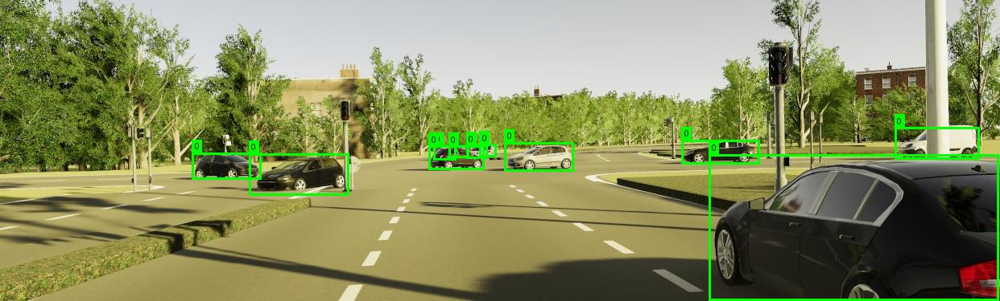

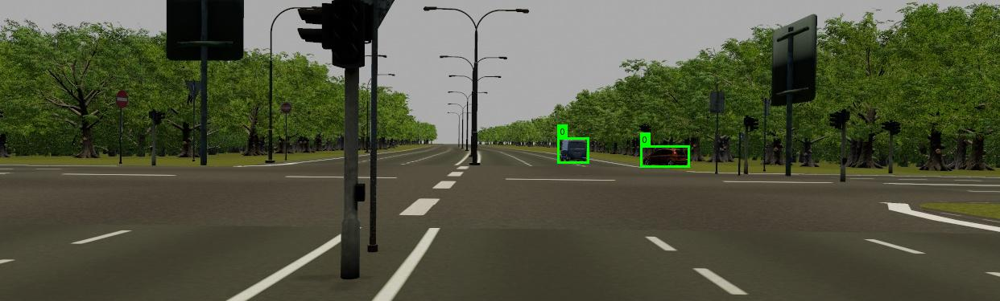

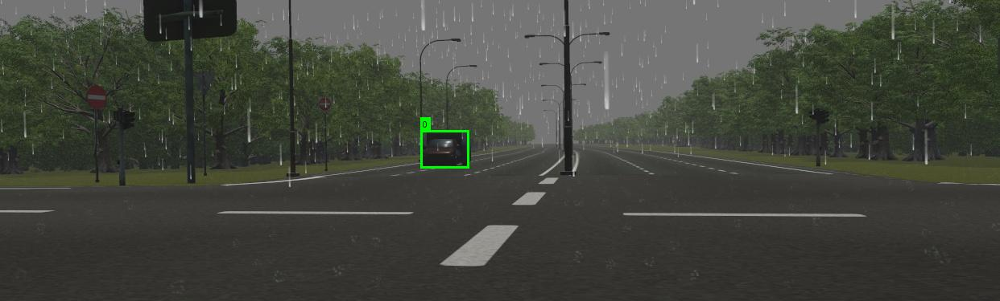

In [52]:
# visualize the labels for some training images to ensure that therre is no mismatch
from pathlib import Path
import random
import os
from typing import List, Tuple
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

LIST_FILE = Path("lists/train.txt")   # change if needed
OUT_DIR   = Path("vis_train")
SAMPLES   = 16                        # how many images to visualize
SEED      = 42                        # reproducibility
CLASS_NAMES = None  # Optional: e.g., ["car", "truck", "van"]; if None, shows class id

# ---------- Helpers ----------
def read_image_list(list_file: Path) -> List[Path]:
    if list_file.is_file():
        lines = [l.strip() for l in list_file.read_text(encoding="utf-8").splitlines() if l.strip()]
        return [Path(l) for l in lines]
    raise FileNotFoundError(f"Could not find list file: {list_file}")

def find_label_path(img_path: Path) -> Path:
    # label is next to image, same stem, .txt
    return img_path.with_suffix(".txt")

def parse_yolo_label_line(line: str) -> Tuple[int, float, float, float, float]:
    # supports: cls cx cy w h [extra...]
    parts = line.strip().split()
    if len(parts) < 5:
        raise ValueError(f"Bad label line (need >=5 columns): '{line}'")
    c = int(float(parts[0]))
    cx, cy, w, h = map(float, parts[1:5])
    return c, cx, cy, w, h

def yolo_to_xyxy(cx, cy, w, h, W, H):
    x1 = (cx - w/2) * W
    y1 = (cy - h/2) * H
    x2 = (cx + w/2) * W
    y2 = (cy + h/2) * H
    return max(0, x1), max(0, y1), min(W-1, x2), min(H-1, y2)

def draw_boxes(pil_img: Image.Image, boxes, color=(0, 255, 0)):
    draw = ImageDraw.Draw(pil_img)
    try:
        font = ImageFont.load_default()
    except:
        font = None
    for (cls_id, xyxy) in boxes:
        x1, y1, x2, y2 = xyxy
        draw.rectangle([x1, y1, x2, y2], outline=color, width=3)
        tag = CLASS_NAMES[cls_id] if (CLASS_NAMES and 0 <= cls_id < len(CLASS_NAMES)) else str(cls_id)
        tw, th = draw.textlength(tag, font=font), 12
        draw.rectangle([x1, y1 - th - 4, x1 + (tw or 50) + 6, y1], fill=color)
        draw.text((x1 + 3, y1 - th - 2), tag, fill=(0, 0, 0), font=font)
    return pil_img

# ---------- Main ----------
def main():
    OUT_DIR.mkdir(parents=True, exist_ok=True)
    imgs = read_image_list(LIST_FILE)

    if len(imgs) == 0:
        raise RuntimeError("No image paths found in the list file.")

    random.Random(SEED).shuffle(imgs)
    sample = imgs[:SAMPLES]

    report = {
        "total_checked": 0,
        "missing_label": 0,
        "empty_label": 0,
        "bad_lines": 0,
        "out_of_range_vals": 0,
        "images_saved": 0,
    }

    for i, img_path in enumerate(sample, 1):
        report["total_checked"] += 1
        if not img_path.exists():
            print(f"[WARN] Missing image: {img_path}")
            continue

        lbl_path = find_label_path(img_path)
        if not lbl_path.exists():
            report["missing_label"] += 1
            print(f"[WARN] Label not found for {img_path.name}: {lbl_path}")
            # still save the image (no boxes) to spot wrong naming
            pil = Image.open(img_path).convert("RGB")
            pil.save(OUT_DIR / f"{i:02d}_NO_LABEL_{img_path.stem}.jpg")
            report["images_saved"] += 1
            continue

        lines = [l for l in lbl_path.read_text(encoding="utf-8").splitlines() if l.strip()]
        if len(lines) == 0:
            report["empty_label"] += 1

        pil = Image.open(img_path).convert("RGB")
        W, H = pil.size
        boxes_draw = []

        for line in lines:
            try:
                cls_id, cx, cy, w, h = parse_yolo_label_line(line)
                # sanity: normalized values should be within [0,1]
                if not (0 <= cx <= 1 and 0 <= cy <= 1 and 0 < w <= 1 and 0 < h <= 1):
                    report["out_of_range_vals"] += 1
                    # continue drawing anyway to see what's wrong
                xyxy = yolo_to_xyxy(cx, cy, w, h, W, H)
                boxes_draw.append((cls_id, xyxy))
            except Exception as e:
                report["bad_lines"] += 1
                print(f"[WARN] {lbl_path.name}: {e}")

        pil = draw_boxes(pil, boxes_draw)
        out_name = OUT_DIR / f"{i:02d}_{img_path.stem}.jpg"
        pil.save(out_name)
        report["images_saved"] += 1

    # Grid preview (optional)
    try:
        import math
        from PIL import ImageOps
        saved = sorted(OUT_DIR.glob("*.jpg"))
        n = min(len(saved), SAMPLES)
        if n > 0:
            cols = 4
            rows = math.ceil(n / cols)
            thumbs = []
            for p in saved[:n]:
                im = Image.open(p).convert("RGB")
                im = ImageOps.contain(im, (640, 640))
                thumbs.append(im)
            grid_w = cols * thumbs[0].width
            grid_h = rows * thumbs[0].height
            grid = Image.new("RGB", (grid_w, grid_h), (30, 30, 30))
            for idx, im in enumerate(thumbs):
                r, c = divmod(idx, cols)
                grid.paste(im, (c * im.width, r * im.height))
            grid.save(OUT_DIR / "_grid_preview.jpg")
            print(f"[OK] Saved grid preview to {OUT_DIR / '_grid_preview.jpg'}")
    except Exception as e:
        print(f"[INFO] Skipped grid preview: {e}")

    # Report
    print("\n=== Sanity Report ===")
    for k, v in report.items():
        print(f"{k:18s}: {v}")
    print(f"\nAnnotated samples saved in: {OUT_DIR.resolve()}")
    print("Open a few to visually confirm boxes align with objects.")

if __name__ == "__main__":
    main()


# ---------- display some of them
import random
img_dir = OUT_DIR
# List a few overlay images
all_images = [f for f in os.listdir(img_dir)]

# Randomly select 5 images
selected_images = random.sample(all_images, 3)

# Display them
for img_name in selected_images:
    img_path = os.path.join(img_dir, img_name)
    display(Image.open(img_path))

In [ ]:


import shutil
import re
from pathlib import Path

# =======================
# ====== CONFIG =========
# =======================
TRAIN_LIST = Path(r"lists\train.txt")
VAL_LIST   = Path(r"lists\val.txt")

# Where your *labels* currently live (separate root you mentioned)
LABELS_ROOT = Path(
    r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_label_inYoloFormat\labels"
)

# New clean dataset root to create (Ultralytics-friendly images/ ↔ labels/)
DATASET_ROOT = Path(
    r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_yolo"
)

# Number of classes / valid ids: 0..NC-1
NC = 3
NAMES = ["car", "truck", "van"]  # 0,1,2

# If you want to shorten the copied folder structure for images, set this to True
DROP_FRAMES_SEGMENT = True  # removes 'frames\rgb\' from the mirrored subtree for the *new* dataset

# =======================
# ====== HELPERS ========
# =======================

SCENE_RE = re.compile(r"^Scene\d+$", re.IGNORECASE)
CAM_RE   = re.compile(r"^camera_\d+$", re.IGNORECASE)

def path_parts_lower(p: Path):
    """Return tuple of path parts lowercased (for robust matching)."""
    return tuple(part.lower() for part in p.parts)

def extract_scene_condition_camera_from_image(img_path: Path):
    """
    From an image path like:
      ...\vkitti_dataset\Scene18\clone\frames\rgb\Camera_0\rgb_00001.jpg
    return ('Scene18','clone','camera_0')
    """
    parts = img_path.parts
    parts_lower = path_parts_lower(img_path)

    # 1) Scene
    scene_idx = -1
    for i, pl in enumerate(parts_lower):
        if SCENE_RE.match(pl):
            scene_idx = i
            break
    if scene_idx == -1 or scene_idx + 1 >= len(parts):
        raise ValueError(f"Could not parse Scene/condition from: {img_path}")

    scene = parts[scene_idx]  # keep original case (e.g., Scene18)
    condition = parts[scene_idx + 1]  # e.g., clone, overcast, etc.

    # 2) Camera folder: try to find the last directory before filename that matches camera_\d+
    # Typical image path: ... frames / rgb / Camera_0 / rgb_XXXXX.jpg
    # We'll scan directories (exclude filename) from right to left.
    camera = None
    for pl, p in zip(reversed(parts_lower[:-1]), reversed(parts[:-1])):
        if CAM_RE.match(pl):
            camera = p.lower()  # we standardize labels path as lowercase
            break
    if camera is None:
        # Fallback: some vkitti layouts put camera directly under condition
        # Try the segment after condition
        if scene_idx + 2 < len(parts_lower) and CAM_RE.match(parts_lower[scene_idx + 2]):
            camera = parts[scene_idx + 2].lower()
        else:
            raise ValueError(f"Could not find camera folder in: {img_path}")

    return scene, condition, camera  # camera returned in lowercase for labels path

def map_image_to_current_label(img_path: Path) -> Path:
    """
    Build the label path under LABELS_ROOT:
      LABELS_ROOT / SceneXX / condition / camera_0 / <stem>.txt
    """
    scene, condition, camera = extract_scene_condition_camera_from_image(img_path)
    return LABELS_ROOT / scene / condition / camera / (img_path.stem + ".txt")

def build_rel_dst_under_images(img_path: Path) -> Path:
    """
    Decide the relative path used when copying images/labels into the new dataset.
    If DROP_FRAMES_SEGMENT is True, we drop 'frames/rgb' from the middle.
    e.g., Scene18/clone/frames/rgb/Camera_0/rgb_00001.jpg -> Scene18/clone/Camera_0/rgb_00001.jpg
    """
    parts = img_path.parts
    parts_lower = path_parts_lower(img_path)

    # Keep subtree starting at 'SceneXX/...'
    scene_idx = -1
    for i, pl in enumerate(parts_lower):
        if SCENE_RE.match(pl):
            scene_idx = i
            break
    if scene_idx == -1:
        # fallback: keep relative to the drive root
        rel = Path(*parts[1:]) if img_path.drive else img_path
    else:
        rel = Path(*parts[scene_idx:])

    if DROP_FRAMES_SEGMENT:
        # Remove 'frames' (and optionally 'rgb') if present
        rel_parts = list(rel.parts)
        rel_parts_lower = [p.lower() for p in rel_parts]
        if "frames" in rel_parts_lower:
            j = rel_parts_lower.index("frames")
            # If next is 'rgb', drop both; else drop only 'frames'
            drop_count = 1
            if j + 1 < len(rel_parts_lower) and rel_parts_lower[j + 1] == "rgb":
                drop_count = 2
            rel_parts = rel_parts[:j] + rel_parts[j + drop_count:]
            rel = Path(*rel_parts)

    return rel

def is_valid_yolo_line(line: str, nc: int) -> bool:
    try:
        cols = line.split()
        if len(cols) != 5:
            return False
        cid = int(float(cols[0]))
        if not (0 <= cid < nc):
            return False
        x, y, w, h = map(float, cols[1:])
        return (0.0 <= x <= 1.0) and (0.0 <= y <= 1.0) and (0.0 <= w <= 1.0) and (0.0 <= h <= 1.0)
    except Exception:
        return False

def copy_split(split_name: str, list_file: Path):
    imgs = [Path(s.strip()) for s in list_file.read_text(encoding="utf-8").splitlines() if s.strip()]
    copied_img = 0; copied_lbl = 0; miss_lbl = 0; empty_lbl = 0; bad_lbl_lines = 0; no_valid_lines = 0; missing_img = 0

    for img in imgs:
        if not img.exists():
            print(f"[WARN] Missing image: {img}")
            missing_img += 1
            continue

        # 1) Find current label file under LABELS_ROOT
        lbl_src = map_image_to_current_label(img)

        # 2) Decide destination relative subtree
        rel = build_rel_dst_under_images(img)
        dst_img = DATASET_ROOT / "images" / split_name / rel
        dst_lbl = (DATASET_ROOT / "labels" / split_name / rel).with_suffix(".txt")

        # 3) Copy image
        dst_img.parent.mkdir(parents=True, exist_ok=True)
        shutil.copy2(img, dst_img)
        copied_img += 1

        # 4) Validate + copy label
        if not lbl_src.exists():
            miss_lbl += 1
            continue
        lines = [ln.strip() for ln in lbl_src.read_text(encoding="utf-8").splitlines() if ln.strip()]
        if not lines:
            empty_lbl += 1
            continue

        valid_any = False
        for ln in lines:
            if is_valid_yolo_line(ln, NC):
                valid_any = True
            else:
                bad_lbl_lines += 1

        if not valid_any:
            no_valid_lines += 1
            continue

        dst_lbl.parent.mkdir(parents=True, exist_ok=True)
        shutil.copy2(lbl_src, dst_lbl)
        copied_lbl += 1

    print(f"\n=== {split_name.upper()} SUMMARY ===")
    print(f"Images copied:                {copied_img}")
    print(f"Labels copied (passed check): {copied_lbl}")
    print(f"Missing label files:          {miss_lbl}")
    print(f"Empty label files:            {empty_lbl}")
    print(f"Files with only invalid lines:{no_valid_lines}")
    print(f"Bad/invalid label lines:      {bad_lbl_lines}")
    print(f"Missing images in list:       {missing_img}")

# =======================
# ========= RUN =========
# =======================
DATASET_ROOT.mkdir(parents=True, exist_ok=True)

copy_split("train", TRAIN_LIST)
copy_split("val",   VAL_LIST)

# Emit a YAML suggestion you can paste into data\vkitti_yolo.yaml
yaml_path = DATASET_ROOT / "vkitti_yolo.yaml"
yaml_text = f"""# Auto-generated example
path: {DATASET_ROOT}
train: images/train
val: images/val
names:
  0: {NAMES[0]}
  1: {NAMES[1]}
  2: {NAMES[2]}
"""
yaml_path.write_text(yaml_text, encoding="utf-8")

print(f"\nNew dataset laid out at: {DATASET_ROOT}")
print(f"Sample YAML written to:  {yaml_path}")
print("Reminder: delete any *.cache files that may exist next to OLD image folders before training.")



=== TRAIN SUMMARY ===
Images copied:                3052
Labels copied (passed check): 3052
Missing label files:          0
Empty label files:            0
Files with only invalid lines:0
Bad/invalid label lines:      0
Missing images in list:       0

=== VAL SUMMARY ===
Images copied:                500
Labels copied (passed check): 500
Missing label files:          0
Empty label files:            0
Files with only invalid lines:0
Bad/invalid label lines:      0
Missing images in list:       0

New dataset laid out at: C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_yolo
Sample YAML written to:  C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_yolo\vkitti_yolo.yaml
Reminder: delete any *.cache files that may exist next to OLD image folders before training.


In [ ]:
# Create a new folder ""vkitti training data" that contains the training
# data with labels in a pth structure expected by YOLO

import shutil
import re
from pathlib import Path

# ========= CONFIG =========
TRAIN_LIST = Path(r"lists\train.txt")
VAL_LIST   = Path(r"lists\val.txt")

IMAGES_ROOT = Path(r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_dataset")
LABELS_ROOT = Path(r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_label_inYoloFormat\labels")

NEW_ROOT = Path(r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti training data")

NAMES = ["car", "truck", "van"]  # class ids 0,1,2
NC = len(NAMES)

# Drop 'frames/rgb' from the middle of the destination tree for tidiness
DROP_FRAMES_SEGMENT = True

# ========= HELPERS =========
SCENE_RE = re.compile(r"^Scene\d+$", re.IGNORECASE)

def find_scene_condition_camera(img_path: Path):
    parts = img_path.parts
    scene = None
    cond  = None
    # scene + condition by scanning for 'SceneXX'
    for i, p in enumerate(parts):
        if SCENE_RE.match(p):
            scene = parts[i]      # keep original casing (e.g., Scene18)
            cond  = parts[i+1] if i+1 < len(parts) else None
            break
    # camera by scanning from right to left (dirs only)
    cam = None
    for p in reversed(parts[:-1]):
        if p.lower().startswith("camera_"):
            cam = p               # keep original casing for the NEW dataset tree
            break
    if not (scene and cond and cam):
        raise ValueError(f"Could not parse scene/condition/camera from: {img_path}")
    return scene, cond, cam

def label_source_path(img_path: Path) -> Path:
    """Map image path -> current label file under LABELS_ROOT (camera dir is lowercase there)."""
    scene, cond, cam = find_scene_condition_camera(img_path)
    cam_lower = cam.lower()
    return LABELS_ROOT / scene / cond / cam_lower / (img_path.stem + ".txt")

def dest_rel_under_images(img_path: Path) -> Path:
    """Build the relative subpath to use under NEW_ROOT/images|labels."""
    parts = img_path.parts
    # keep subtree starting at 'SceneXX'
    start = None
    for i, p in enumerate(parts):
        if SCENE_RE.match(p):
            start = i
            break
    rel = Path(*parts[start:]) if start is not None else Path(*parts[1:])  # fallback to drop drive

    if DROP_FRAMES_SEGMENT:
        rel_parts = list(rel.parts)
        rel_low   = [p.lower() for p in rel_parts]
        if "frames" in rel_low:
            j = rel_low.index("frames")
            # drop frames and optional 'rgb'
            drop = 1 + (1 if j + 1 < len(rel_parts) and rel_low[j+1] == "rgb" else 0)
            rel_parts = rel_parts[:j] + rel_parts[j+drop:]
            rel = Path(*rel_parts)
    return rel

def valid_yolo_line(line: str) -> bool:
    try:
        cols = line.split()
        if len(cols) != 5: return False
        cid = int(float(cols[0]))
        if not (0 <= cid < NC): return False
        x, y, w, h = map(float, cols[1:])
        return all(0.0 <= v <= 1.0 for v in (x,y,w,h))
    except Exception:
        return False

def copy_split(split: str, list_file: Path):
    imgs = [Path(s.strip()) for s in list_file.read_text(encoding="utf-8").splitlines() if s.strip()]
    copied_img = copied_lbl = miss_lbl = empty_lbl = invalid_only = bad_lines = miss_img = 0

    for img in imgs:
        if not img.exists():
            print(f"[WARN] Missing image: {img}")
            miss_img += 1
            continue

        # where to put the image/label in the new dataset
        rel = dest_rel_under_images(img)
        dst_img = NEW_ROOT / "images" / split / rel
        dst_lbl = (NEW_ROOT / "labels" / split / rel).with_suffix(".txt")

        # copy image
        dst_img.parent.mkdir(parents=True, exist_ok=True)
        shutil.copy2(img, dst_img)
        copied_img += 1

        # find + validate label (from separate LABELS_ROOT)
        lbl_src = label_source_path(img)
        if not lbl_src.exists():
            miss_lbl += 1
            # Uncomment to see where we looked:
            # print(f"[MISS LBL] {lbl_src}")
            continue

        lines = [ln.strip() for ln in lbl_src.read_text(encoding="utf-8").splitlines() if ln.strip()]
        if not lines:
            empty_lbl += 1
            continue

        ok_any = False
        for ln in lines:
            if valid_yolo_line(ln):
                ok_any = True
            else:
                bad_lines += 1

        if not ok_any:
            invalid_only += 1
            continue

        dst_lbl.parent.mkdir(parents=True, exist_ok=True)
        shutil.copy2(lbl_src, dst_lbl)
        copied_lbl += 1

    print(f"\n=== {split.upper()} SUMMARY ===")
    print(f"Images copied:                  {copied_img}")
    print(f"Labels copied (passed check):   {copied_lbl}")
    print(f"Missing label files:            {miss_lbl}")
    print(f"Empty label files:              {empty_lbl}")
    print(f"Files with only invalid lines:  {invalid_only}")
    print(f"Bad/invalid label lines total:  {bad_lines}")
    print(f"Missing images in list:         {miss_img}")

# ========= RUN =========
NEW_ROOT.mkdir(parents=True, exist_ok=True)
copy_split("train", TRAIN_LIST)
copy_split("val",   VAL_LIST)

# Write YOLO data YAML
yaml_path = NEW_ROOT / "vkitti_yolo.yaml"
yaml_text = f"""# Auto-generated YOLO data file
path: "{NEW_ROOT}"
train: images/train
val: images/val
names:
  0: {NAMES[0]}
  1: {NAMES[1]}
  2: {NAMES[2]}
"""
yaml_path.write_text(yaml_text, encoding="utf-8")

print(f"\nNew dataset created at: {NEW_ROOT}")
print(f"YAML written to:        {yaml_path}")
print("Next: delete any *.cache files near OLD image folders (if any), then train using this YAML.")



=== TRAIN SUMMARY ===
Images copied:                  3052
Labels copied (passed check):   3052
Missing label files:            0
Empty label files:              0
Files with only invalid lines:  0
Bad/invalid label lines total:  0
Missing images in list:         0

=== VAL SUMMARY ===
Images copied:                  500
Labels copied (passed check):   500
Missing label files:            0
Empty label files:              0
Files with only invalid lines:  0
Bad/invalid label lines total:  0
Missing images in list:         0

New dataset created at: C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti training data
YAML written to:        C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti training data\vkitti_yolo.yaml
Next: delete any *.cache files near OLD image folders (if any), then train using this YAML.


In [ ]:
# Sanity check

from pathlib import Path

root = Path(r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti training data")
for split in ("train","val"):
    imgs = sorted((root/"images"/split).rglob("*.jpg"))
    lbls = [ (root/"labels"/split/img.relative_to(root/"images"/split)).with_suffix(".txt") for img in imgs ]
    missing = [str(p) for p in lbls if not p.exists()]
    print(f"{split}: images={len(imgs)}, labels_missing={len(missing)}")
    for p in missing[:5]:
        print("  missing:", p)


train: images=3052, labels_missing=0
val: images=500, labels_missing=0


In [ ]:
# Test before running the real training 

from ultralytics import YOLO
model = YOLO('yolov8n.pt')

results = model.train(
    data=r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti training data\vkitti_yolo.yaml",
    epochs=1,
    imgsz=640,
    batch=4,         
    workers=2,        
    plots=True,
)
print("Run dir:", results.save_dir)


In [ ]:
from ultralytics import YOLO

model = YOLO('yolov8n.pt')  # or yolov8s.pt for better accuracy

results = model.train(
    data=r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti training data\vkitti_yolo.yaml",
    epochs=50,
    patience=20,       
    batch=16,         
    imgsz=640,
    save_period=5,
    device='cpu',     
    workers=4,
    optimizer='AdamW',  # Better for precision
    lr0=0.001,          # Lower learning rate
    lrf=0.01,           # Final learning rate
    # adapted the training parameters to put the focus on the precision compared to recall 
    # Validation
    val=True,
    split=0.2,          # Not used since you specify val set
    save_json=True,     # Save COCO format results
    name='vkitti_3class_improved'
)

New https://pypi.org/project/ultralytics/8.3.203 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.200  Python-3.10.18 torch-2.3.1 CPU (Intel Core i7-14700)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti training data\vkitti_yolo.yaml, degrees=0.0, deterministic=True, device=cpu, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, mo

## Evaluation using COCO 

**Methodology:**
To validate and compare performance across conditions, we use the COCO evaluation framework. Inference is performed for both the pre-trained and fine-tuned YOLO models on the subset2 dataset. Predictions and ground truth are converted from YOLO format to COCO format before running the evaluation.

**Metrics:**
We report the standard COCO detection metrics:
- AP5095, AP50, AP75 – Average Precision across IoU thresholds.
- AP_small, AP_medium, AP_large – Precision by object scale.
- AR1, AR10, AR100 – Average Recall with different detection caps.
- AR_small, AR_medium, AR_large – Recall by object scale.

### Function definition

#### Convert YOLO Ground-truth (GT) to COCO GT

In [ ]:
from pathlib import Path
from ultralytics import YOLO


def yolo_gt_to_coco(gt_dirs, subset_file, out_json):
    
    import json
    from PIL import Image

    YOLO2COCO_GT = {0:1, 1:2, 2:3} # label conversion YOLO -> COCO
    def read_subset_paths(sf):
        return [Path(s) for s in Path(sf).read_text().splitlines() if s.strip()]

    subset_paths = read_subset_paths(subset_file)
    # images[] / img_idx
    images, img_idx = [], {}
    image_id = 1
    sizes = {}
    for p in subset_paths:
        with Image.open(p) as im:
            W, H = im.size
        images.append({"id": image_id, "file_name": p.name, "width": W, "height": H})
        img_idx[p.stem] = (image_id, W, H, p.name)
        sizes[p.stem] = (W, H)
        image_id += 1

    annos = []
    ann_id = 1
    # helper to find a GT txt across multiple roots
    def find_gt(stem):
        for d in gt_dirs:
            f = d / f"{stem}.txt"
            if f.exists(): return f
        return None

    for p in subset_paths:
        stem = p.stem # corresponds to 
        gt_fp = find_gt(stem)
        if not gt_fp: 
            continue
        image_id, W, H, _ = img_idx[stem]
        for line in gt_fp.read_text().splitlines():
            parts = line.strip().split()
            if len(parts) < 5: continue
            cid = int(parts[0])
            if cid not in YOLO2COCO_GT: continue
            xc, yc, w, h = map(float, parts[1:5])
            x = (xc - w/2.0) * W
            y = (yc - h/2.0) * H
            bw = w * W
            bh = h * H
            x = max(0.0, x); y = max(0.0, y)
            bw = max(0.0, min(bw, W - x))
            bh = max(0.0, min(bh, H - y))
            if bw <= 1e-6 or bh <= 1e-6: continue
            annos.append({
                "id": ann_id, "image_id": image_id, "category_id": YOLO2COCO_GT[cid],
                "bbox": [x,y,bw,bh], "area": float(bw*bh), "iscrowd": 0, "segmentation": []
            })
            ann_id += 1

    coco = {
        "info": {                                   # <-- add this
            "description": "VKITTI2 eval",
            "version": "1.0",
            "year": 2025,
            "contributor": "your_name",
            "date_created": "2025-09-27"
        },
        "licenses": [],                             # <-- optional but common
        "images": images,
        "annotations": annos,
        "categories": [
            {"id": 1, "name": "car"},
            {"id": 2, "name": "truck"},
            {"id": 3, "name": "van"}
        ]
    }
    out_json = Path(out_json)
    out_json.parent.mkdir(parents=True, exist_ok=True)
    out_json.write_text(json.dumps(coco, indent=2))
    return images, img_idx





#### Inference and convert the YOLO prediction to COCO format

In [3]:
# Run inference from the exact same subset

def run_inference(subset_file, cond, model, project_name, conf = 0.5):
    name_cond = f"pred_{cond}"
    #model = YOLO("yolov8n.pt")
    results = model.predict(
        source=[str(p) for p in Path(subset_file).read_text().splitlines() if p.strip()],
        imgsz=960, 
        conf=conf, 
        device="cpu",
        project= project_name, 
        name=name_cond,
        save=True, save_txt=True, save_conf=True, exist_ok=True, batch=1,
        #classes=[2,8],  # COCO: car, truck
    )

In [4]:
# 2d) Build COCO preds from the same subset
def yolo_pred_to_coco(pred_labels_dir: Path, subset_file: Path, out_json: Path, img_idx: dict):
    COCO2COCO_PRED = {0:1, 1:2, 2:3}
    dets = []
    stems = [Path(s).stem for s in Path(subset_file).read_text().splitlines() if s.strip()]
    for stem in stems:
        f = Path(pred_labels_dir) / f"{stem}.txt"
        if not f.exists(): 
            continue
        image_id, W, H, _ = img_idx[stem]
        for line in f.read_text().splitlines():
            parts = line.strip().split()
            if len(parts) < 6: continue
            cid = int(float(parts[0]))
            if cid not in COCO2COCO_PRED: continue
            xc,yc,w,h,score = map(float, parts[1:6])
            x = (xc - w/2.0) * W; y = (yc - h/2.0) * H
            bw = w * W;         bh = h * H
            x = max(0.0, x); y = max(0.0, y)
            bw = max(0.0, min(bw, W - x)); bh = max(0.0, min(bh, H - y))
            if bw <= 1e-6 or bh <= 1e-6: continue
            dets.append({"image_id": image_id, "category_id": COCO2COCO_PRED[cid],
                         "bbox": [x,y,bw,bh], "score": float(score)})
    out_json = Path(out_json); out_json.parent.mkdir(parents=True, exist_ok=True)
    out_json.write_text(__import__("json").dumps(dets, indent=2))

# pred_labels_dir = Path(r"runs/vkitti2/pred_fog/labels")
# det_json = Path("reports/fog_det.json")

# yolo_pred_to_coco(pred_labels_dir, subset_file, det_json, img_idx)

#### Evaluate with COCO 

In [9]:
# Evaluate (COCO) with per-class AP *and* AR
import numpy as np
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval

def evaluation_coco(gt_json, det_json):
    coco_gt = COCO(str(gt_json))
    coco_dt = coco_gt.loadRes(str(det_json))
    ev = COCOeval(coco_gt, coco_dt, iouType="bbox")
    ev.evaluate(); ev.accumulate(); ev.summarize()

    # ---- overall (12 standard stats) ----
    names = ["mAP5095","mAP50","mAP75","AP_small","AP_medium","AP_large",
             "AR1","AR10","AR100","AR_small","AR_medium","AR_large"]
    summary = {k: float(v) for k, v in zip(names, ev.stats)}

    # ---- per-class APs ----
    precis = ev.eval["precision"]  # [T, R, K, A, M]
    if precis.size == 0:
        return {"summary": summary, "per_class": {}}

    iou_thrs = ev.params.iouThrs
    area_lbls = ev.params.areaRngLbl  # ['all','small','medium','large']
    max_dets_list = ev.params.maxDets  # e.g. [1,10,100]

    # helper to find index
    def idx(lst, val, default=None):
        try:
            return list(lst).index(val)
        except ValueError:
            return default

    a_all   = idx(area_lbls, 'all', 0)
    a_small = idx(area_lbls, 'small', a_all)
    a_medium= idx(area_lbls, 'medium', a_all)
    a_large = idx(area_lbls, 'large', a_all)

    m_1   = idx(max_dets_list, 1, None)
    m_10  = idx(max_dets_list, 10, None)
    m_100 = idx(max_dets_list, 100, None)
    if m_100 is None:  # fall back to the last available
        m_100 = len(max_dets_list) - 1

    # IoU indices for AP50/75
    i50 = idx(np.round(iou_thrs, 2), 0.50)
    i75 = idx(np.round(iou_thrs, 2), 0.75)

    cat_ids = ev.params.catIds
    id_to_name = {c["id"]: c["name"] for c in coco_gt.loadCats(cat_ids)}
    per_class = {}

    # Count GT instances per class
    gt_counts = {cid: len(coco_gt.getAnnIds(catIds=[cid])) for cid in cat_ids}

    # ----- recall tensor -----
    # ev.eval["recall"] shape: [T, K, A, M]
    recall_t = ev.eval.get("recall", None)

    for k_idx, cid in enumerate(cat_ids):
        name = id_to_name.get(cid, str(cid))

        # ---- APs (all areas, maxDets=100) ----
        p_all = precis[:, :, k_idx, a_all, m_100]
        p_all = p_all[p_all > -1]
        ap_5095 = float(np.mean(p_all)) if p_all.size else float('nan')

        # AP@0.50
        if i50 is not None:
            p50 = precis[i50, :, k_idx, a_all, m_100]
            p50 = p50[p50 > -1]
            ap_50 = float(np.mean(p50)) if p50.size else float('nan')
        else:
            ap_50 = float('nan')

        # AP@0.75
        if i75 is not None:
            p75 = precis[i75, :, k_idx, a_all, m_100]
            p75 = p75[p75 > -1]
            ap_75 = float(np.mean(p75)) if p75.size else float('nan')
        else:
            ap_75 = float('nan')

        # size-specific APs
        def ap_area(a_idx):
            p = precis[:, :, k_idx, a_idx, m_100]
            p = p[p > -1]
            return float(np.mean(p)) if p.size else float('nan')

        ap_small  = ap_area(a_small)
        ap_medium = ap_area(a_medium)
        ap_large  = ap_area(a_large)

        # ---- ARs (per-class recall) ----
        # Average across IoU thresholds (T), ignoring -1
        def ar_at(m_idx, a_idx):
            if recall_t is None or m_idx is None:
                return float('nan')
            r = recall_t[:, k_idx, a_idx, m_idx]  # [T]
            r = r[r > -1]
            return float(np.mean(r)) if r.size else float('nan')

        ar100_all   = ar_at(m_100, a_all)
        ar10_all    = ar_at(m_10,  a_all)
        ar1_all     = ar_at(m_1,   a_all)
        ar_small    = ar_at(m_100, a_small)
        ar_medium   = ar_at(m_100, a_medium)
        ar_large    = ar_at(m_100, a_large)

        per_class[name] = {
            # AP
            "AP5095": ap_5095,
            "AP50": ap_50,
            "AP75": ap_75,
            "AP_small": ap_small,
            "AP_medium": ap_medium,
            "AP_large": ap_large,
            # AR
            "AR100": ar100_all,
            "AR10": ar10_all,
            "AR1": ar1_all,
            "AR_small": ar_small,
            "AR_medium": ar_medium,
            "AR_large": ar_large,
            # support
            "n_gt": int(gt_counts[cid]),
        }

    return {"summary": summary, "per_class": per_class}


### Pre-Trained Model Evaluation

In [ ]:
# === Main run of COCO evaluation (GT format conversion + inference + Pred format conversion)
from pathlib import Path
import pandas as pd
from ultralytics import YOLO

gt_base = Path(r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_label_inYoloFormat\labels")
cam = "Camera_0"
scenes = (1, 2, 6, 18, 20) #(18, 20)  # 
conditions = ("clone", "fog", "morning", "rain", "overcast", "sunset")

Path("reports").mkdir(parents=True, exist_ok=True)

# use the pre-trained model
model = YOLO('yolov8s.pt')

summary_rows = []          # overall per-condition metrics
per_class_rows = []        # per-condition x per-class metrics

for cond in conditions:
    try:
        print(f"\n=== {cond.upper()} ===")

        # 1) subset file for this condition
        subset_file = Path(f"subsets2/pred_{cond}.txt")
        if not subset_file.exists():
            print(f"[WARN] Missing subset file: {subset_file} — skipping {cond}")
            continue

        # Filter out Scene18 frames 0-24 
        original_paths = [line for line in subset_file.read_text().splitlines() if line.strip()]
        filtered_paths = []
        for line in original_paths:
            p = Path(line)
            if "Scene18" in str(p):
                try:
                    frame = int(p.stem.split('_')[-1])
                    if frame < 25:
                        print(f"Skipping {p.name} (no label)")
                        continue
                except Exception:
                    pass
            filtered_paths.append(line)
        
        
        # Write a filtered copy in subsets2/
        filtered_subset = subset_file.with_name(subset_file.stem + "_filtered.txt")
        filtered_subset.write_text("\n".join(filtered_paths))
        print(f"Filtered subset: {len(original_paths)} --> {len(filtered_paths)} images")
        subset_file = filtered_subset  # from here on, use the filtered file

        # 2) GT label dirs for this condition across the selected scenes
        gt_dirs = [
            gt_base / f"Scene{int(s):02d}" / cond / cam
            for s in scenes
        ]
        gt_dirs = [d for d in gt_dirs if d.exists()]
        if not gt_dirs:
            print(f"[WARN] No GT label directories found for condition '{cond}' — skipping")
            continue

        # 3) Output JSON paths
        gt_json  = Path(f"reports_pretrained/{cond}_gt.json")
        det_json = Path(f"reports_pretrained/{cond}_det.json")

        # 4) Where predictions will be saved by your inference step
        pred_labels_dir = Path(f"runs/vkitti2_CocoEval_pretrained/pred_{cond}/labels")

        # A) Build COCO GT JSON (returns images list and index map)
        images, img_idx = yolo_gt_to_coco(gt_dirs, subset_file, gt_json)

        # B) Run inference for this subset+condition
        # print(f"len subset file : {len(subset_file)}")
        run_inference(subset_file, cond, model, project_name="runs/vkitti2_CocoEval_pretrained", conf=0.7)

        # C) Convert YOLO preds → COCO det JSON, using same subset and the img_idx from (A)
        yolo_pred_to_coco(pred_labels_dir, subset_file, det_json, img_idx)

        # D) Evaluate with COCO API (NEW: also returns per_class)
        metrics = evaluation_coco(gt_json, det_json)

        # ---- overall
        row = {"condition": cond}
        row.update(metrics.get("summary", {}))
        summary_rows.append(row)

        # ---- per-class
        per_class = metrics.get("per_class", {})
        for cls_name, vals in per_class.items():
            # vals includes AP5095, AP50, AP75, AP_small, AP_medium, AP_large, recall metrics, n_gt
            per_class_row = {"condition": cond, "class": cls_name}
            per_class_row.update(vals)
            per_class_rows.append(per_class_row)

        print(f"[OK] Done: {cond} → GT: {gt_json.name}, DET: {det_json.name}")

    except Exception as e:
        print(f"[ERR] {cond}: {e}")
        import traceback
        traceback.print_exc()


=== CLONE ===
Filtered subset: 150 --> 150 images

0: 320x960 4 cars, 96.4ms
1: 320x960 5 cars, 96.4ms
2: 320x960 5 cars, 96.4ms
3: 320x960 5 cars, 96.4ms
4: 320x960 5 cars, 96.4ms
5: 320x960 5 cars, 96.4ms
6: 320x960 4 cars, 96.4ms
7: 320x960 5 cars, 96.4ms
8: 320x960 5 cars, 96.4ms
9: 320x960 4 cars, 96.4ms
10: 320x960 3 cars, 96.4ms
11: 320x960 3 cars, 96.4ms
12: 320x960 4 cars, 96.4ms
13: 320x960 4 cars, 96.4ms
14: 320x960 4 cars, 96.4ms
15: 320x960 5 cars, 96.4ms
16: 320x960 4 cars, 96.4ms
17: 320x960 5 cars, 96.4ms
18: 320x960 5 cars, 96.4ms
19: 320x960 5 cars, 96.4ms
20: 320x960 4 cars, 1 bench, 96.4ms
21: 320x960 4 cars, 1 bench, 96.4ms
22: 320x960 5 cars, 1 bench, 96.4ms
23: 320x960 6 cars, 1 bench, 96.4ms
24: 320x960 4 cars, 96.4ms
25: 320x960 5 cars, 96.4ms
26: 320x960 5 cars, 1 bench, 96.4ms
27: 320x960 5 cars, 96.4ms
28: 320x960 4 cars, 96.4ms
29: 320x960 4 cars, 96.4ms
30: 320x960 2 cars, 1 truck, 96.4ms
31: 320x960 2 cars, 1 truck, 96.4ms
32: 320x960 3 cars, 1 truck, 96

In [11]:
# ----- Save overall summary
summary_cols = [
    "condition",
    "mAP5095","mAP50","mAP75",
    "AP_small","AP_medium","AP_large",
    "AR1","AR10","AR100",
    "AR_small","AR_medium","AR_large",
]
df_summary_pretrained = pd.DataFrame(summary_rows)
df_summary = df_summary_pretrained[[c for c in summary_cols if c in df_summary_pretrained.columns]]
df_summary.to_csv("reports_pretrained/metrics_summary.csv", index=False)
print("Saved the results to reports_pretrained/metrics_summary.csv")

df_summary.head(6)

    

Saved the results to reports_pretrained/metrics_summary.csv


,condition,mAP5095,mAP50,mAP75,AP_small,AP_medium,AP_large,AR1,AR10,AR100,AR_small,AR_medium,AR_large
0,clone,0.000160,0.000684,0.000087,0.0,0.000646,0.0,0.0,0.0,0.021111,0.0,0.021111,0.0
1,fog,0.000278,0.000825,0.000216,0.0,0.000493,0.0,0.0,0.0,0.034444,0.0,0.034444,0.0
2,morning,0.000066,0.000441,0.000000,0.0,0.000354,0.0,0.0,0.0,0.005556,0.0,0.005556,0.0
3,rain,0.000156,0.000680,0.000089,0.0,0.000595,0.0,0.0,0.0,0.022222,0.0,0.022222,0.0
4,overcast,0.000551,0.001401,0.000551,0.0,0.001349,0.0,0.0,0.0,0.048889,0.0,0.048889,0.0
5,sunset,0.000159,0.000692,0.000084,0.0,0.000752,0.0,0.0,0.0,0.022222,0.0,0.022222,0.0


In [ ]:
# ----- Save per-class metrics (AP + AR)
per_class_cols_pref = [
    "condition","class",
    # APs
    "AP5095","AP50","AP75",
    "AP_small","AP_medium","AP_large",
    # ARs (new)
    "AR100","AR10","AR1",
    "AR_small","AR_medium","AR_large",
    # support
    "n_gt",
]

df_per_class = pd.DataFrame(per_class_rows)

if not df_per_class.empty:
    # keep only present columns, preserving intended order
    cols_present = [c for c in per_class_cols_pref if c in df_per_class.columns]
    extras = [c for c in df_per_class.columns if c not in cols_present]
    df_per_class = df_per_class[cols_present + extras]

    out_csv = "reports_pretrained/metrics_per_class.csv"
    df_per_class.to_csv(out_csv, index=False)
    print(f"Saved per-class results to {out_csv}")

    # peek first 12 rows
    display(df_per_class.head(12))
else:
    print("[INFO] No per-class rows were produced (empty df_per_class).")


Saved per-class results to reports_pretrained/metrics_per_class.csv


,condition,class,AP5095,AP50,AP75,AP_small,AP_medium,AP_large,AR100,AR10,AR1,AR_small,AR_medium,AR_large,n_gt
0,clone,car,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,1490
1,clone,truck,0.000000,0.000000,0.000000,NaN,0.000000,0.0,0.000000,0.0,0.0,NaN,0.000000,0.0,120
2,clone,van,0.000479,0.002053,0.000262,NaN,0.001939,NaN,0.063333,0.0,0.0,NaN,0.063333,NaN,150
3,fog,car,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,1490
4,fog,truck,0.000000,0.000000,0.000000,NaN,0.000000,0.0,0.000000,0.0,0.0,NaN,0.000000,0.0,120
5,fog,van,0.000835,0.002475,0.000648,NaN,0.001478,NaN,0.103333,0.0,0.0,NaN,0.103333,NaN,150
6,morning,car,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,1490
7,morning,truck,0.000000,0.000000,0.000000,NaN,0.000000,0.0,0.000000,0.0,0.0,NaN,0.000000,0.0,120
8,morning,van,0.000198,0.001323,0.000000,NaN,0.001061,NaN,0.016667,0.0,0.0,NaN,0.016667,NaN,150
9,rain,car,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,1490


In [24]:
# --------- Save detections

from pathlib import Path
import pandas as pd

root = Path("runs/vkitti2_CocoEval_pretrained")
class_names = {0:"car", 1:"truck", 2:"van"}

# collect all predictions into a single DataFrame, each row is one box
records = []

for pred_dir in sorted(root.glob("pred_*")):
    cond = pred_dir.stem.replace("pred_", "")
    label_dir = pred_dir / "labels"
    
    if not label_dir.exists():
        print("Skipping missing:", label_dir)
        continue
    
    for txt_path in sorted(label_dir.glob("*.txt")):
        img_id = txt_path.stem # setm is the filename without suffix
        
        for line in txt_path.read_text().splitlines():
            if len(line.strip()) < 1:
                continue
            cls, x_center, y_center, width, height, conf = line.split()
            records.append({
                "condition": cond,
                "image_id": img_id,
                "class_id": int(cls),
                "class_name": class_names.get(int(cls), "unknown"),
                "x_center": float(x_center),
                "y_center": float(y_center),
                "width": float(width),
                "height": float(height),
                "area": float(width) * float(height),
                "conf": float(conf),
            })

df = pd.DataFrame(records)

# summarise in csv files

# sum_path = root / "summary"
# sum_path.mkdir(parents=True, exist_ok=True)

by_condition = df.groupby("condition").agg(
    detections = ("image_id", "count"),
    mean_conf = ("conf", "mean"),
    mean_area = ("area", "mean"),
    imgz = ("image_id", "nunique"),
)
by_condition.to_csv("reports_pretrained/detections_by_condition.csv")

by_cond_class = df.groupby(["condition", "class_name"]).agg(
    detections = ("image_id", "count"),
    mean_conf = ("conf", "mean"),
    mean_area = ("area", "mean"),
    imgz = ("image_id", "nunique"),
).reset_index()
display(by_cond_class.sort_values(["condition","class_name"]))

,condition,class_name,detections,mean_conf,mean_area,imgz
0,clone,unknown,70,0.813633,0.019974,29
1,clone,van,554,0.852674,0.025275,30
2,fog,unknown,15,0.773026,0.036781,13
3,fog,van,530,0.858486,0.027431,30
4,morning,unknown,77,0.770608,0.018992,30
5,morning,van,564,0.850958,0.025236,30
6,overcast,car,1,0.716264,0.003749,1
7,overcast,unknown,33,0.840195,0.030702,24
8,overcast,van,571,0.849731,0.025045,30
9,rain,car,1,0.724817,0.003718,1


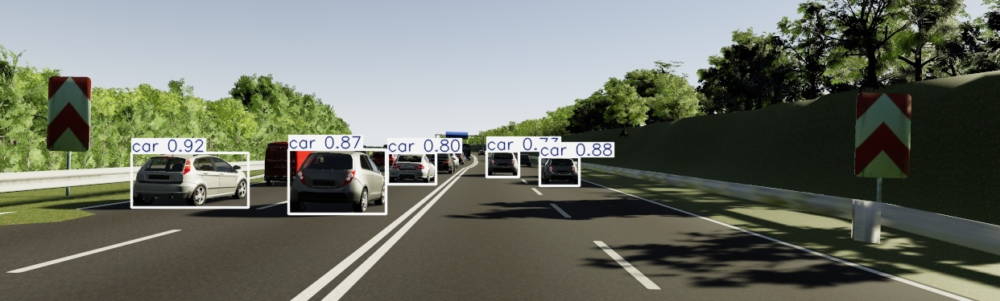

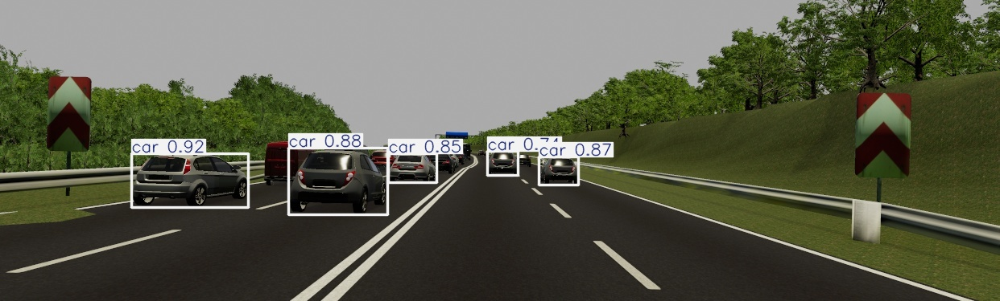

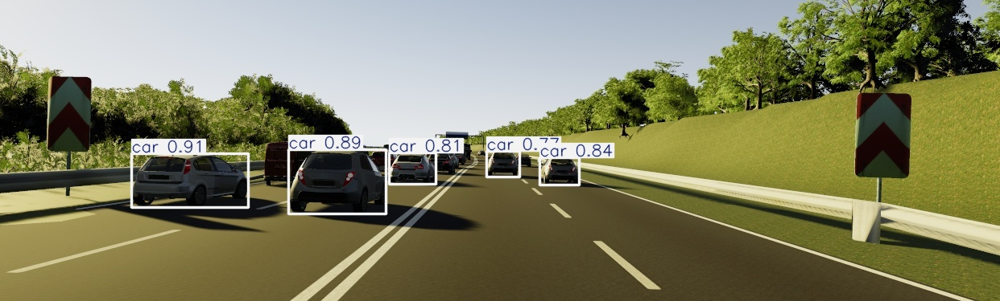

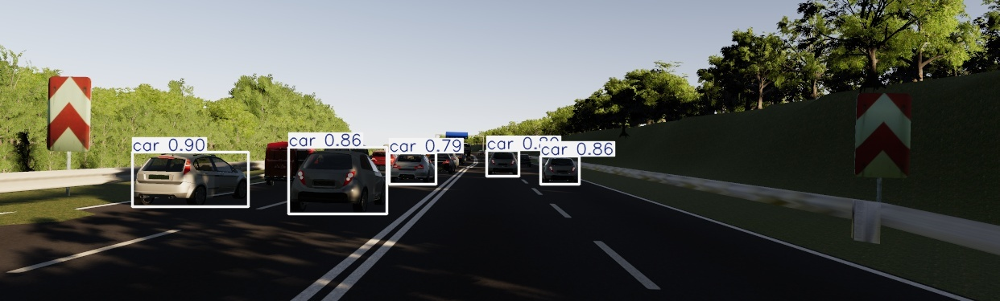

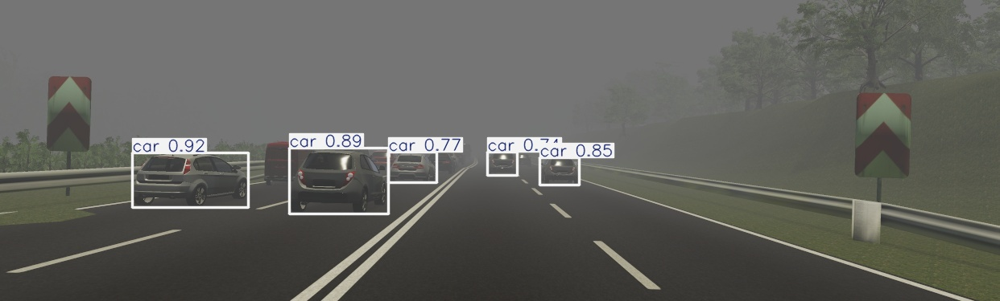

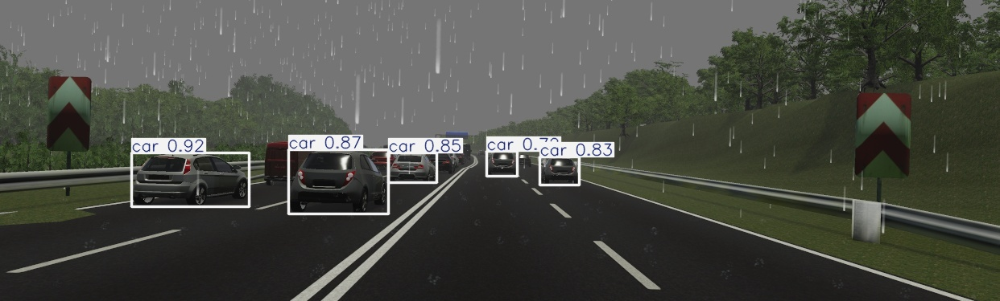

In [25]:
# Display prediction results for the same image for different coonditions 
from PIL import Image
from IPython.display import display

pred_dir = Path("runs/vkitti2_CocoEval_pretrained")
for name in ["pred_clone", "pred_overcast", "pred_morning", "pred_sunset", "pred_fog", "pred_rain"]:
    folder = pred_dir / name
    imgs = folder.glob("*.jpg")
    img_path = next(imgs)  # get the first image
    display(Image.open(img_path))

Wrote overlays to reports_pretrained\viz_eval_COCO


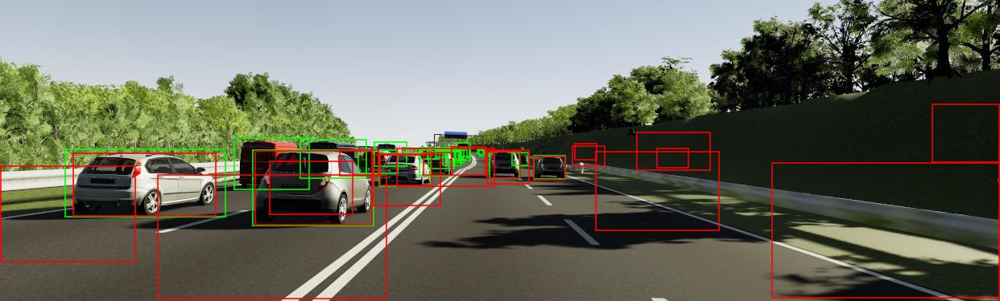

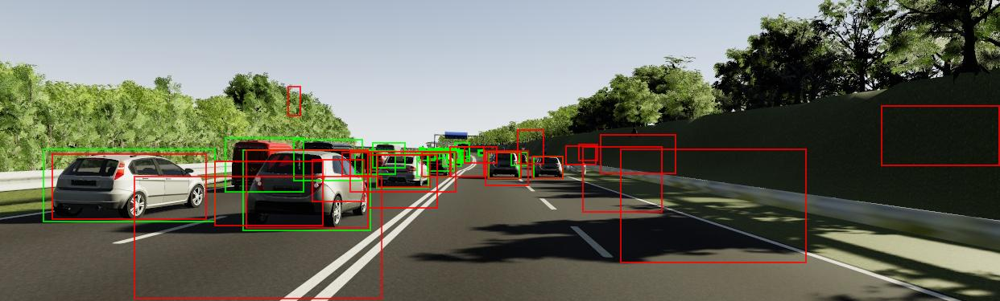

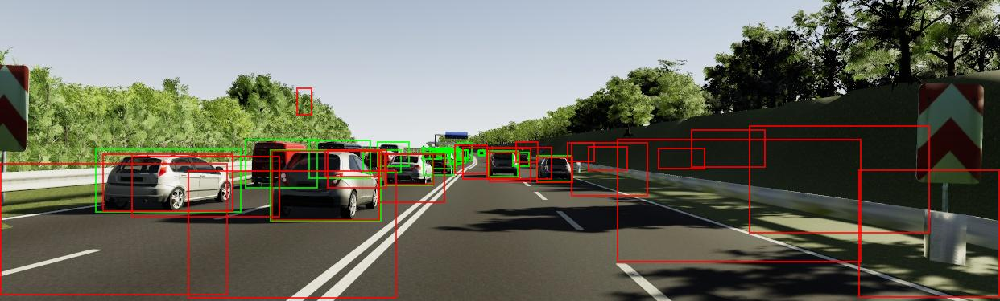

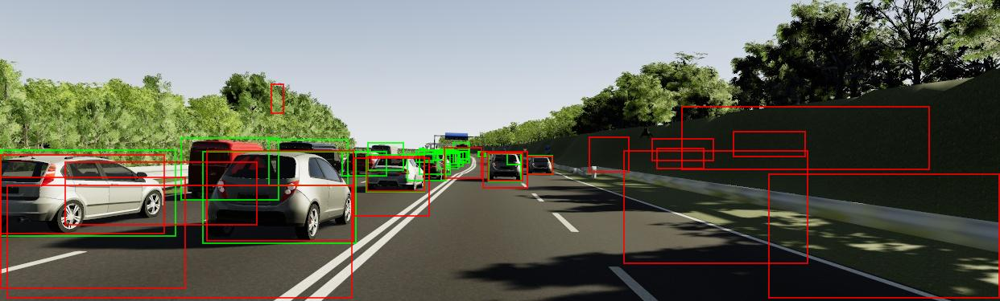

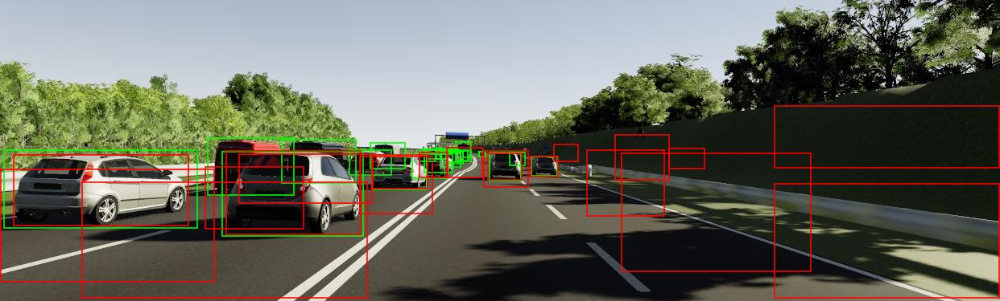

In [32]:
## Vizualise the overlayed image between predictions boxes (red) and GT boxes (green)

from pathlib import Path
from PIL import Image, ImageDraw
from IPython.display import display
import os 

# Use the subset file that matches your predictions
subset_file = Path("subsets2/pred_clone.txt")  # Change condition as needed
subset_list = [line.strip() for line in subset_file.read_text().splitlines() if line.strip()]
subset_list = subset_list[-100:]
label_root = Path(r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_label_inYoloFormat\labels")
pred_labels_dir = Path("runs/vkitti2_CocoEval_pretrained/pred_clone/labels")  # Update this path
CAMERA = "Camera_0"

# FIXED: Build label index that matches scene/condition structure
def build_label_index(label_root, camera):
    """Build index that matches scene/condition structure from image paths"""
    lbl_index = {}
    for label_file in label_root.rglob(f"*/{camera}/*.txt"):
        # Extract scene and condition from path
        parts = label_file.parts
        scene_idx = None
        condition_idx = None
        
        for i, part in enumerate(parts):
            if part.startswith('Scene'):
                scene_idx = i
            elif scene_idx and i == scene_idx + 1:  # Next part after Scene
                condition_idx = i
                break
        
        if scene_idx and condition_idx:
            scene = parts[scene_idx]
            condition = parts[condition_idx]
            filename = label_file.stem
            key = f"{scene}/{condition}/{filename}"
            lbl_index[key] = label_file
    
    return lbl_index

lbl_index = build_label_index(label_root, CAMERA)

out_dir = Path("reports_pretrained/viz_eval_COCO"); out_dir.mkdir(exist_ok=True)

def read_yolo(lbl_path, W, H, has_score=False):
    out=[]
    if not lbl_path or not lbl_path.exists(): return out
    for ln in lbl_path.read_text().splitlines():
        ps = ln.strip().split()
        if len(ps) < (6 if has_score else 5): continue
        c = int(float(ps[0]))
        xc, yc, w, h = map(float, ps[1:5])
        x1 = (xc - w/2) * W; y1 = (yc - h/2) * H
        x2 = (xc + w/2) * W; y2 = (yc + h/2) * H
        out.append((c, x1, y1, x2, y2))
    return out

for s in subset_list:  # Now using subset_list instead of val_list
    ip = Path(s)
    
    # FIXED: Extract scene and condition from image path
    img_parts = ip.parts
    scene_idx = None
    condition_idx = None
    
    for j, part in enumerate(img_parts):
        if part.startswith('Scene'):
            scene_idx = j
        elif scene_idx and j == scene_idx + 1:
            condition_idx = j
            break
    
    if scene_idx and condition_idx:
        scene = img_parts[scene_idx]
        condition = img_parts[condition_idx]
        label_key = f"{scene}/{condition}/{ip.stem}"
        gt = lbl_index.get(label_key)
    else:
        gt = None
    
    with Image.open(ip) as im:
        W, H = im.size
        im = im.convert("RGB")
        draw = ImageDraw.Draw(im, "RGBA")
        
        # GT in green
        gt_boxes = read_yolo(gt, W, H, has_score=False)
        for c,x1,y1,x2,y2 in gt_boxes:
            draw.rectangle([x1,y1,x2,y2], outline=(0,255,0,200), width=2)
        
        # Preds in red
        pred = pred_labels_dir / f"{ip.stem}.txt"
        pred_boxes = read_yolo(pred, W, H, has_score=True)
        for c,x1,y1,x2,y2 in pred_boxes:
            draw.rectangle([x1,y1,x2,y2], outline=(255,0,0,200), width=2)
        
        # # Debug output
        # counter = 0
        # while counter < 1:
        #     print(f"Image: {ip.name} | GT boxes: {len(gt_boxes)} | Pred boxes: {len(pred_boxes)}")
        #     counter +=1
        im.save(out_dir / f"{ip.stem}_overlay.jpg")

print("Wrote overlays to", out_dir)

# ---------- display some of them
import random
# List a few overlay images (e.g., first 5)
all_images = [f for f in os.listdir(out_dir) if f.endswith("_overlay.jpg")]

# Randomly select 5 images
selected_images = random.sample(all_images, 5)

# Display them
for img_name in selected_images:
    img_path = os.path.join(out_dir, img_name)
    display(Image.open(img_path))

### Trained model Evaluation 

In [17]:
# === Main run of COCO evaluation (GT format conversion + inference + Pred format conversion)
from pathlib import Path
import pandas as pd
from ultralytics import YOLO

gt_base = Path(r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_label_inYoloFormat\labels")
cam = "Camera_0"
scenes = (1, 2, 6, 18, 20) #(18, 20)  # 
conditions = ("clone", "fog", "morning", "rain", "overcast", "sunset")

Path("reports").mkdir(parents=True, exist_ok=True)

# use the trained model
weight_dir = r"runs\detect\vkitti_3class_improved7\weights\last.pt"
model_trained = YOLO(weight_dir)
# model = YOLO('yolov8s.pt')

summary_rows = []          # overall per-condition metrics
per_class_rows = []        # per-condition x per-class metrics

for cond in conditions:
    try:
        print(f"\n=== {cond.upper()} ===")

        # 1) subset file for this condition
        subset_file = Path(f"subsets2/pred_{cond}.txt")
        if not subset_file.exists():
            print(f"[WARN] Missing subset file: {subset_file} — skipping {cond}")
            continue

        # Filter out Scene18 frames 0-24
        original_paths = [line for line in subset_file.read_text().splitlines() if line.strip()]
        filtered_paths = []
        for line in original_paths:
            p = Path(line)
            if "Scene18" in str(p):
                try:
                    frame = int(p.stem.split('_')[-1])
                    if frame < 25:
                        print(f"Skipping {p.name} (no label)")
                        continue
                except Exception:
                    pass
            filtered_paths.append(line)
        
        
        # Write a filtered copy in subsets2/
        filtered_subset = subset_file.with_name(subset_file.stem + "_filtered.txt")
        filtered_subset.write_text("\n".join(filtered_paths))
        print(f"Filtered subset: {len(original_paths)} --> {len(filtered_paths)} images")
        subset_file = filtered_subset  # from here on, use the filtered file

        # 2) GT label dirs for this condition across the selected scenes
        gt_dirs = [
            gt_base / f"Scene{int(s):02d}" / cond / cam
            for s in scenes
        ]
        gt_dirs = [d for d in gt_dirs if d.exists()]
        if not gt_dirs:
            print(f"[WARN] No GT label directories found for condition '{cond}' — skipping")
            continue

        # 3) Output JSON paths
        gt_json  = Path(f"reports_trained/{cond}_gt.json")
        det_json = Path(f"reports_trained/{cond}_det.json")

        # 4) Where predictions will be saved by your inference step
        pred_labels_dir = Path(f"runs/vkitti2_CocoEval_trained/pred_{cond}/labels")

        # ---- RUN THE 4 STEPS ----
        # A) Build COCO GT JSON (returns images list and index map)
        images, img_idx = yolo_gt_to_coco(gt_dirs, subset_file, gt_json)

        # B) Run inference for this subset+condition
        # print(f"len subset file : {len(subset_file)}")
        run_inference(subset_file, cond, model_trained, project_name="runs/vkitti2_CocoEval_trained", conf=0.7)

        # C) Convert YOLO preds → COCO det JSON, using same subset and the img_idx from (A)
        yolo_pred_to_coco(pred_labels_dir, subset_file, det_json, img_idx)

        # D) Evaluate with COCO API (NEW: also returns per_class)
        metrics = evaluation_coco(gt_json, det_json)

        # ---- overall
        row = {"condition": cond}
        row.update(metrics.get("summary", {}))
        summary_rows.append(row)

        # ---- per-class
        per_class = metrics.get("per_class", {})
        for cls_name, vals in per_class.items():
            # vals includes AP5095, AP50, AP75, AP_small, AP_medium, AP_large, recall metrics, n_gt
            per_class_row = {"condition": cond, "class": cls_name}
            per_class_row.update(vals)
            per_class_rows.append(per_class_row)

        print(f"[OK] Done: {cond} → GT: {gt_json.name}, DET: {det_json.name}")

    except Exception as e:
        print(f"[ERR] {cond}: {e}")
        import traceback
        traceback.print_exc()


=== CLONE ===
Filtered subset: 150 --> 150 images

0: 320x960 8 cars, 1 truck, 1 van, 46.0ms
1: 320x960 8 cars, 1 truck, 1 van, 46.0ms
2: 320x960 8 cars, 1 truck, 1 van, 46.0ms
3: 320x960 9 cars, 1 truck, 1 van, 46.0ms
4: 320x960 9 cars, 1 truck, 1 van, 46.0ms
5: 320x960 9 cars, 1 truck, 1 van, 46.0ms
6: 320x960 8 cars, 1 truck, 1 van, 46.0ms
7: 320x960 8 cars, 1 truck, 1 van, 46.0ms
8: 320x960 8 cars, 1 truck, 1 van, 46.0ms
9: 320x960 8 cars, 1 truck, 1 van, 46.0ms
10: 320x960 7 cars, 1 truck, 1 van, 46.0ms
11: 320x960 8 cars, 1 truck, 1 van, 46.0ms
12: 320x960 6 cars, 1 truck, 1 van, 46.0ms
13: 320x960 7 cars, 1 truck, 1 van, 46.0ms
14: 320x960 8 cars, 1 truck, 1 van, 46.0ms
15: 320x960 6 cars, 1 truck, 1 van, 46.0ms
16: 320x960 7 cars, 1 van, 46.0ms
17: 320x960 9 cars, 1 van, 46.0ms
18: 320x960 9 cars, 1 van, 46.0ms
19: 320x960 9 cars, 1 van, 46.0ms
20: 320x960 9 cars, 1 van, 46.0ms
21: 320x960 8 cars, 1 van, 46.0ms
22: 320x960 8 cars, 1 van, 46.0ms
23: 320x960 8 cars, 1 van, 46.0m

In [18]:
# ----- Save overall summary
summary_cols = [
    "condition",
    "mAP5095","mAP50","mAP75",
    "AP_small","AP_medium","AP_large",
    "AR1","AR10","AR100",
    "AR_small","AR_medium","AR_large",
]
df_summary = pd.DataFrame(summary_rows)
df_summary = df_summary[[c for c in summary_cols if c in df_summary.columns]]
df_summary.to_csv("reports_trained/metrics_summary.csv", index=False)
print("Saved the results to reports_trained/metrics_summary.csv")

df_summary.head(6)

    

Saved the results to reports_trained/metrics_summary.csv


,condition,mAP5095,mAP50,mAP75,AP_small,AP_medium,AP_large,AR1,AR10,AR100,AR_small,AR_medium,AR_large
0,clone,0.250504,0.281013,0.277071,0.0,0.261754,0.383221,0.028009,0.257252,0.704931,0.0,0.619530,0.955532
1,fog,0.250232,0.293229,0.281412,0.0,0.246564,0.380911,0.020123,0.293024,0.691997,0.0,0.617503,0.942447
2,morning,0.240958,0.278991,0.274138,0.0,0.241857,0.370147,0.015155,0.289737,0.691320,0.0,0.605554,0.955532
3,rain,0.243157,0.277120,0.271004,0.0,0.242872,0.384565,0.023093,0.291570,0.677644,0.0,0.601175,0.941915
4,overcast,0.204920,0.234207,0.221879,0.0,0.193166,0.378344,0.018201,0.256898,0.622166,0.0,0.535291,0.958191
5,sunset,0.224718,0.250950,0.246811,0.0,0.212371,0.377759,0.006898,0.261342,0.654597,0.0,0.574744,0.941383


In [19]:
# ----- Save per-class metrics (AP + AR)
per_class_cols_pref = [
    "condition","class",
    # APs
    "AP5095","AP50","AP75",
    "AP_small","AP_medium","AP_large",
    # ARs (new)
    "AR100","AR10","AR1",
    "AR_small","AR_medium","AR_large",
    # support
    "n_gt",
]

df_per_class = pd.DataFrame(per_class_rows)

if not df_per_class.empty:
    # keep only present columns, preserving intended order
    cols_present = [c for c in per_class_cols_pref if c in df_per_class.columns]
    # also keep any unexpected extra columns at the end (if you add more later)
    extras = [c for c in df_per_class.columns if c not in cols_present]
    df_per_class = df_per_class[cols_present + extras]

    out_csv = "reports_trained/metrics_per_class.csv"
    df_per_class.to_csv(out_csv, index=False)
    print(f"Saved per-class results to {out_csv}")

    # (optional) peek first 12 rows
    display(df_per_class.head(12))
else:
    print("[INFO] No per-class rows were produced (empty df_per_class).")


Saved per-class results to reports_trained/metrics_per_class.csv


,condition,class,AP5095,AP50,AP75,AP_small,AP_medium,AP_large,AR100,AR10,AR1,AR_small,AR_medium,AR_large,n_gt
0,clone,car,0.222144,0.237457,0.225629,0.0,0.066684,0.562912,0.443960,0.113423,0.014027,0.0,0.233152,0.951064,1490
1,clone,truck,0.251863,0.272250,0.272250,NaN,0.394079,0.203530,0.787500,0.558333,0.056667,NaN,0.742105,0.960000,120
2,clone,van,0.277507,0.333333,0.333333,NaN,0.324498,NaN,0.883333,0.100000,0.013333,NaN,0.883333,NaN,150
3,fog,car,0.230086,0.249565,0.233802,0.0,0.060179,0.565267,0.473490,0.110738,0.015369,0.0,0.273913,0.964894,1490
4,fog,truck,0.293479,0.333993,0.333993,NaN,0.412572,0.196556,0.829167,0.675000,0.038333,NaN,0.805263,0.920000,120
5,fog,van,0.227131,0.296130,0.276440,NaN,0.266941,NaN,0.773333,0.093333,0.006667,NaN,0.773333,NaN,150
6,morning,car,0.204688,0.224100,0.209539,0.0,0.041882,0.536764,0.443960,0.106711,0.014631,0.0,0.233152,0.951064,1490
7,morning,truck,0.262752,0.286787,0.286787,NaN,0.381895,0.203530,0.783333,0.629167,0.030833,NaN,0.736842,0.960000,120
8,morning,van,0.255435,0.326087,0.326087,NaN,0.301792,NaN,0.846667,0.133333,0.000000,NaN,0.846667,NaN,150
9,rain,car,0.233847,0.256016,0.237669,0.0,0.063832,0.572575,0.489597,0.106376,0.016779,0.0,0.300543,0.963830,1490


In [22]:
from pathlib import Path
import pandas as pd

root = Path("runs/vkitti2_CocoEval_trained")
class_names = {0:"car", 1:"truck", 2:"van"}

# collect all predictions into a single DataFrame, each row is one box
records = []

for pred_dir in sorted(root.glob("pred_*")):
    cond = pred_dir.stem.replace("pred_", "")
    label_dir = pred_dir / "labels"
    
    if not label_dir.exists():
        print("Skipping missing:", label_dir)
        continue
    
    for txt_path in sorted(label_dir.glob("*.txt")):
        img_id = txt_path.stem # setm is the filename without suffix
        
        for line in txt_path.read_text().splitlines():
            if len(line.strip()) < 1:
                continue
            cls, x_center, y_center, width, height, conf = line.split()
            records.append({
                "condition": cond,
                "image_id": img_id,
                "class_id": int(cls),
                "class_name": class_names.get(int(cls), "unknown"),
                "x_center": float(x_center),
                "y_center": float(y_center),
                "width": float(width),
                "height": float(height),
                "area": float(width) * float(height),
                "conf": float(conf),
            })

df = pd.DataFrame(records)

# summarise in csv files

# sum_path = root / "summary"
# sum_path.mkdir(parents=True, exist_ok=True)

by_condition = df.groupby("condition").agg(
    detections = ("image_id", "count"),
    mean_conf = ("conf", "mean"),
    mean_area = ("area", "mean"),
    imgz = ("image_id", "nunique"),
)
by_condition.to_csv("reports_trained/detections_by_condition.csv")

by_cond_class = df.groupby(["condition", "class_name"]).agg(
    detections = ("image_id", "count"),
    mean_conf = ("conf", "mean"),
    mean_area = ("area", "mean"),
    imgz = ("image_id", "nunique"),
).reset_index()
display(by_cond_class.sort_values(["condition","class_name"]))

,condition,class_name,detections,mean_conf,mean_area,imgz
0,clone,car,873,0.901752,0.021327,30
1,clone,truck,62,0.873050,0.021304,30
2,clone,van,91,0.923359,0.016631,30
3,fog,car,945,0.886943,0.020488,30
4,fog,truck,60,0.888881,0.020972,30
5,fog,van,88,0.923124,0.017070,30
6,morning,car,890,0.898871,0.020921,30
7,morning,truck,58,0.888741,0.021333,30
8,morning,van,94,0.921541,0.016731,30
9,overcast,car,927,0.895892,0.020422,30


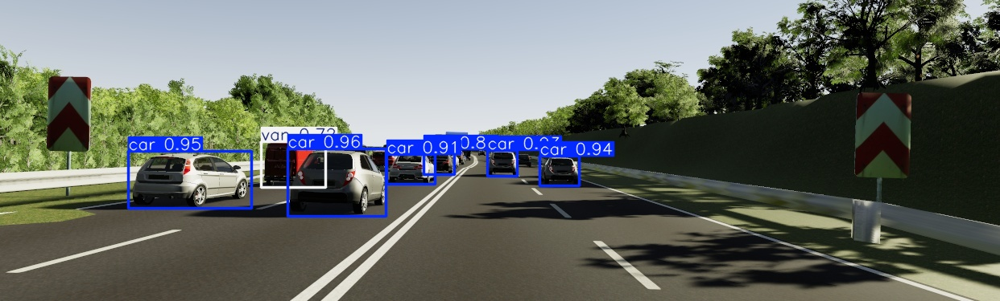

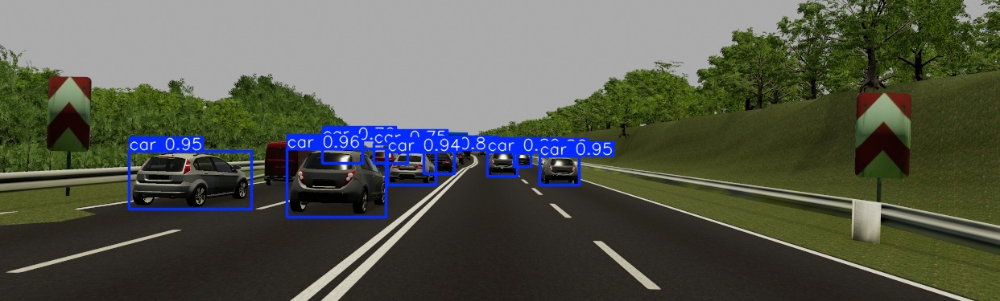

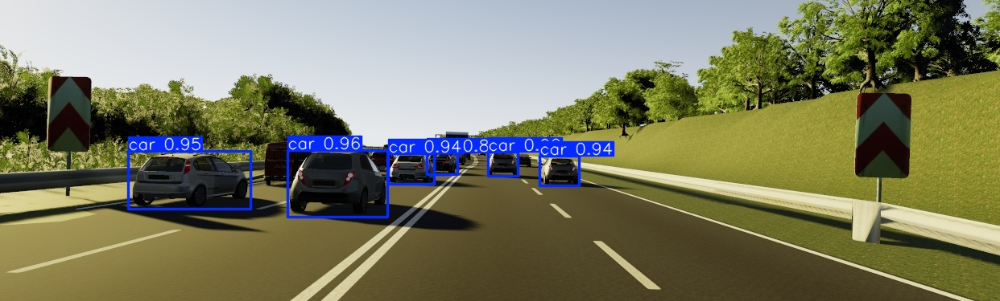

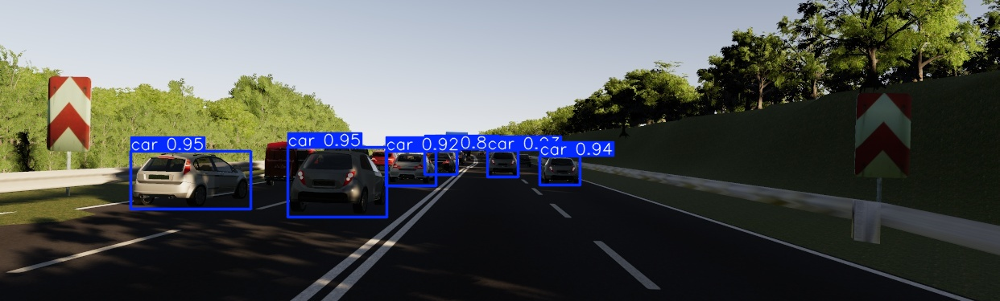

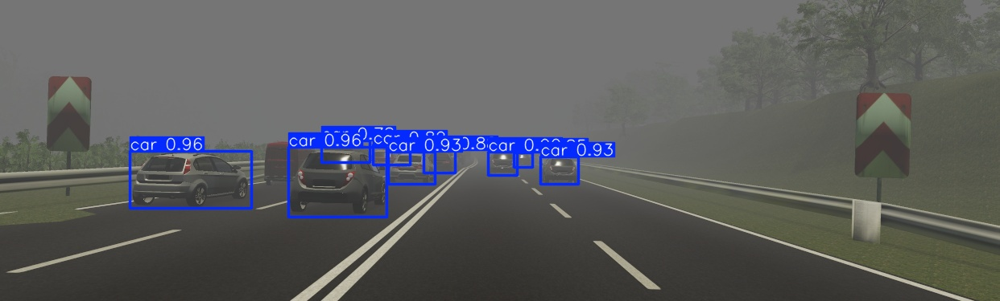

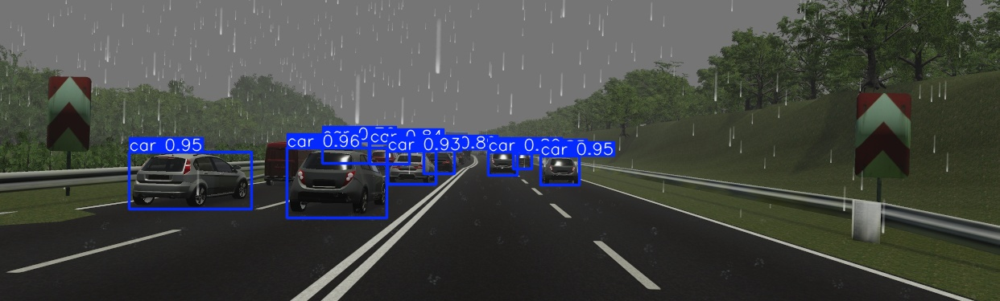

In [23]:
# Display prediction results for the same image for different coonditions 
from PIL import Image
from IPython.display import display

pred_dir = Path("runs/vkitti2_CocoEval_trained")
for name in ["pred_clone", "pred_overcast", "pred_morning", "pred_sunset", "pred_fog", "pred_rain"]:
    folder = pred_dir / name
    imgs = folder.glob("*.jpg")
    img_path = next(imgs)  # get the first image
    display(Image.open(img_path))

Wrote overlays to reports_trained\viz_eval_COCO


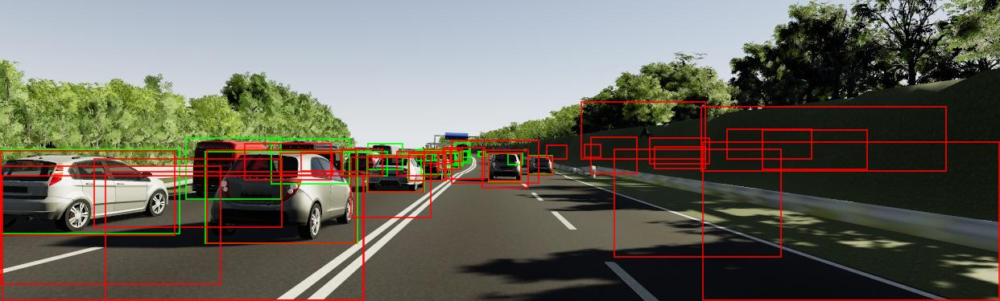

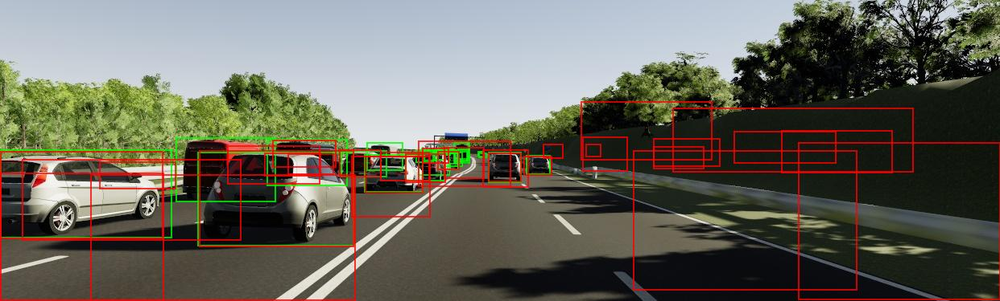

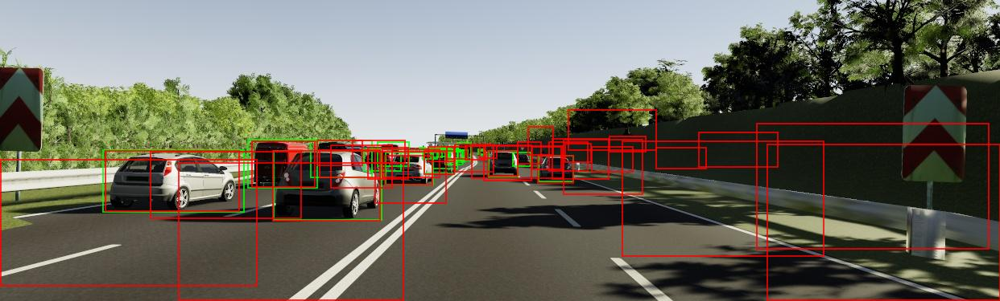

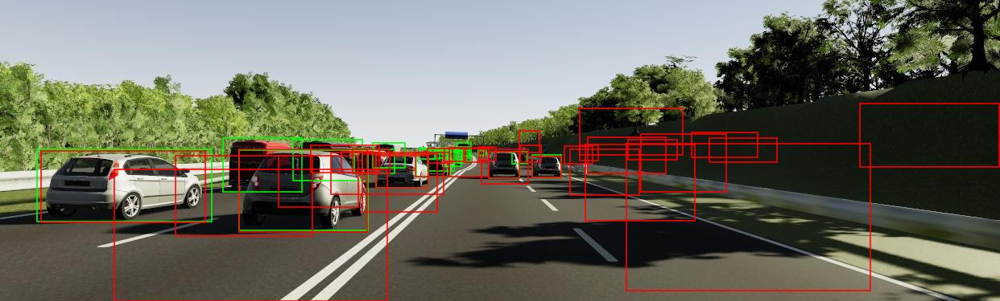

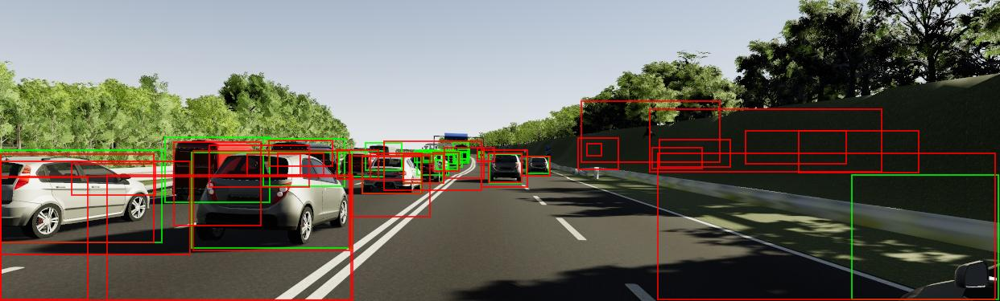

In [ ]:
## Vizualise the overlayed image between predictions boxes (red) and GT boxes (green)

from pathlib import Path
from PIL import Image, ImageDraw
from IPython.display import display
import os 

subset_file = Path("subsets2/pred_clone.txt")  # Change condition as needed
subset_list = [line.strip() for line in subset_file.read_text().splitlines() if line.strip()]
subset_list = subset_list[-100:]
label_root = Path(r"C:\Users\ajinkoji3\OneDrive\Documents\acad.GeorgiaTech\4. Fall 2025\perception_project\vkitti_label_inYoloFormat\labels")
pred_labels_dir = Path("runs/vkitti2_CocoEval_trained/pred_clone/labels")  
CAMERA = "Camera_0"

# Build label index that matches scene/condition structure
def build_label_index(label_root, camera):
    """Build index that matches scene/condition structure from image paths"""
    lbl_index = {}
    for label_file in label_root.rglob(f"*/{camera}/*.txt"):
        # Extract scene and condition from path
        parts = label_file.parts
        scene_idx = None
        condition_idx = None
        
        for i, part in enumerate(parts):
            if part.startswith('Scene'):
                scene_idx = i
            elif scene_idx and i == scene_idx + 1:  # Next part after Scene
                condition_idx = i
                break
        
        if scene_idx and condition_idx:
            scene = parts[scene_idx]
            condition = parts[condition_idx]
            filename = label_file.stem
            key = f"{scene}/{condition}/{filename}"
            lbl_index[key] = label_file
    
    return lbl_index

lbl_index = build_label_index(label_root, CAMERA)

out_dir = Path("reports_trained/viz_eval_COCO"); out_dir.mkdir(exist_ok=True)

def read_yolo(lbl_path, W, H, has_score=False):
    out=[]
    if not lbl_path or not lbl_path.exists(): return out
    for ln in lbl_path.read_text().splitlines():
        ps = ln.strip().split()
        if len(ps) < (6 if has_score else 5): continue
        c = int(float(ps[0]))
        xc, yc, w, h = map(float, ps[1:5])
        x1 = (xc - w/2) * W; y1 = (yc - h/2) * H
        x2 = (xc + w/2) * W; y2 = (yc + h/2) * H
        out.append((c, x1, y1, x2, y2))
    return out

for s in subset_list:  # Now using subset_list instead of val_list
    ip = Path(s)
    
    img_parts = ip.parts
    scene_idx = None
    condition_idx = None
    
    for j, part in enumerate(img_parts):
        if part.startswith('Scene'):
            scene_idx = j
        elif scene_idx and j == scene_idx + 1:
            condition_idx = j
            break
    
    if scene_idx and condition_idx:
        scene = img_parts[scene_idx]
        condition = img_parts[condition_idx]
        label_key = f"{scene}/{condition}/{ip.stem}"
        gt = lbl_index.get(label_key)
    else:
        gt = None
    
    with Image.open(ip) as im:
        W, H = im.size
        im = im.convert("RGB")
        draw = ImageDraw.Draw(im, "RGBA")
        
        # GT in green
        gt_boxes = read_yolo(gt, W, H, has_score=False)
        for c,x1,y1,x2,y2 in gt_boxes:
            draw.rectangle([x1,y1,x2,y2], outline=(0,255,0,200), width=2)
        
        # Preds in red
        pred = pred_labels_dir / f"{ip.stem}.txt"
        pred_boxes = read_yolo(pred, W, H, has_score=True)
        for c,x1,y1,x2,y2 in pred_boxes:
            draw.rectangle([x1,y1,x2,y2], outline=(255,0,0,200), width=2)
        
        # # Debug output
        # counter = 0
        # while counter < 1:
        #     print(f"Image: {ip.name} | GT boxes: {len(gt_boxes)} | Pred boxes: {len(pred_boxes)}")
        #     counter +=1
        im.save(out_dir / f"{ip.stem}_overlay.jpg")

print("Wrote overlays to", out_dir)

# ---------- display some of them
import random
all_images = [f for f in os.listdir(out_dir) if f.endswith("_overlay.jpg")]

# Randomly select 5 images
selected_images = random.sample(all_images, 5)

# Display them
for img_name in selected_images:
    img_path = os.path.join(out_dir, img_name)
    display(Image.open(img_path))

## Results Analysis

1. Overall model performance analysis 
2. Performance analysis across conditions and classes

### Overall trained model performance

**Comment:**
Training on the VKITTI2 dataset significantly improved the performance of the object detection model. The bar charts below illustrate:
- A comparison of mAP@[0.5::0.95], mAP@50 and AR100 between the pre-trained YOLO model and the model fine-tuned on VKITTI2.
- A comparison of mAP50 across different conditions for the two models

In both plots, the bars corresponding to the pre-trained model are barely visible, highlighting that its performance is not comparable in scale to the fine-tuned model.

In absolute terms, the trained model reaches an mAP@[0.5::0.95] of about 0.25 and an AR100 of about 0.7. This indicates that the model is able to detect most objects (reasonable recall), but the precision of detections remains modest.

From an industry perspective, and particularly in the autonomous vehicle domain, these results remain below expectations:
- mAP50 ≈ 0.3 is well below the typical threshold of 0.5–0.6 needed for reliable deployment.
- AR100 ≈ 0.7 is a step in the right direction but ideally should reach 0.85–0.9 in safety-critical applications.

These results emphasize two points:
- Re-training the detector on environment-specific data is crucial for acceptable performance.
- Even after training, achieving the level of robustness and accuracy required for autonomous driving remains a significant challenge.

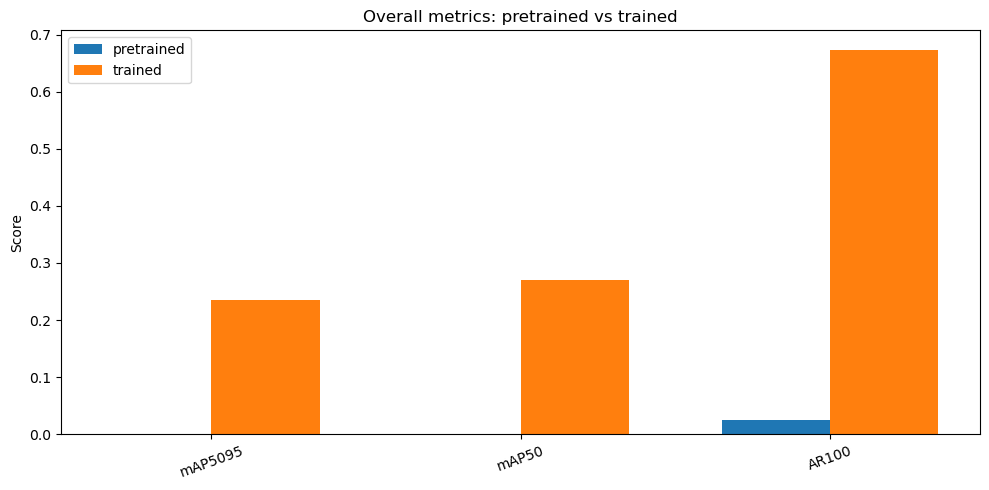

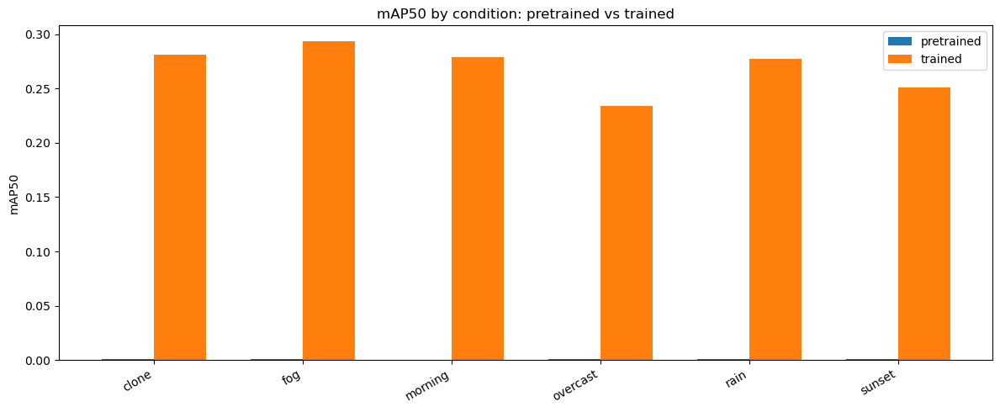

In [ ]:
# Code  to compare the overall performance between the YOLO pretrained model and the trained model 

# compare_models_plots.py
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

path_pretrained = Path("reports_pretrained")
path_trained    = Path("reports_trained")
summary_fname   = "metrics_summary.csv"     # file expected in each folder
# =============================================================

def load_summary(path: Path, label: str) -> pd.DataFrame:
    csv_path = path / summary_fname
    if not csv_path.exists():
        raise FileNotFoundError(f"Missing: {csv_path}")
    df = pd.read_csv(csv_path)
    df["model"] = label
    return df

# Load both summaries
df_pre = load_summary(path_pretrained, "pretrained")
df_tr  = load_summary(path_trained,  "trained")
df = pd.concat([df_pre, df_tr], ignore_index=True)

# ---- 1) Overall metrics bar chart (x-axis = metrics, bars = models) ----
candidate_metrics = [
    'mAP5095', "mAP50",
    #"precision", "recall", "F1",
    "AR100"
]
# print(df.columns)
overall_metrics = [m for m in candidate_metrics if m in df.columns][:6]
if len(overall_metrics) < 1:
    raise RuntimeError("No overall metrics found. Expected something like mAP50, AP5095, precision, recall, F1...")

# Try to detect an "overall" row; otherwise average across conditions per model
def overall_rows(d: pd.DataFrame) -> pd.DataFrame:
    if "condition" in d.columns:
        mask = d["condition"].astype(str).str.lower().isin(["overall", "all", "avg", "average"])
        if mask.any():
            return d.loc[mask, ["model"] + overall_metrics].copy()
    # fallback: mean across conditions per model
    return d.groupby("model", as_index=False)[overall_metrics].mean(numeric_only=True)

overall_df = overall_rows(df)

plt.figure(figsize=(10, 5))
x = np.arange(len(overall_metrics))
models = sorted(overall_df["model"].unique())
width = 0.35
offsets = np.linspace(-width/2, width/2, len(models))

for i, mdl in enumerate(models):
    y = overall_df.loc[overall_df["model"] == mdl, overall_metrics].iloc[0].values.astype(float)
    plt.bar(x + offsets[i], y, width, label=mdl)

plt.xticks(x, overall_metrics, rotation=20)
plt.ylabel("Score")
plt.title("Overall metrics: pretrained vs trained")
plt.legend()
plt.tight_layout()
plt.savefig("overall_metrics_comparison.png", dpi=200)
plt.show()

# ---- 2) AP by condition bar chart (x-axis = condition, bars = models) ----
ap_candidates = ["AP5095", "mAP50", "AP50"]
ap_col = next((c for c in ap_candidates if c in df.columns), None)
if ap_col is None:
    print(f"[info] No AP column found among {ap_candidates}; skipping AP-by-condition plot.")
else:
    if "condition" not in df.columns:
        print("[info] No 'condition' column in metrics_summary.csv; skipping AP-by-condition plot.")
    else:
        ap_df = df.groupby(["condition", "model"], as_index=False)[ap_col].mean(numeric_only=True)
        conditions = sorted(ap_df["condition"].unique(), key=lambda s: str(s))
        x = np.arange(len(conditions))

        plt.figure(figsize=(12, 5))
        for i, mdl in enumerate(models):
            y = (
                ap_df[ap_df["model"] == mdl]
                .set_index("condition")
                .reindex(conditions)[ap_col]
                .values
                .astype(float)
            )
            plt.bar(x + offsets[i], y, width, label=mdl)

        plt.xticks(x, conditions, rotation=30, ha="right")
        plt.ylabel(ap_col)
        plt.title(f"{ap_col} by condition: pretrained vs trained")
        plt.legend()
        plt.tight_layout()
        plt.savefig("ap_by_condition_comparison.png", dpi=200)
        plt.show()


### Performance comparison across conditions and classes

The bar charts below compare AP@[0.5:0.95] and AR@100 across conditions and classes (car, truck, van). In addition, heatmaps (condition × class with AP and AR as color axes) provide a compact view of performance variation, while the relative degradation plots (using clone as baseline) highlight how each condition impacts detection accuracy.

**Per-Conditions Analysis:**

- Overall, clone achieves the best precision and recall, though the margin over other conditions is modest. This is likely because, while clone provides clearer object boundaries, the training dataset was quota-balanced, preventing clone from dominating and reducing the performance gap across conditions.
- Overcast and sunset show the largest degradation relative to clone, while somewhat surprisingly, fog achieves the best performance among the adverse conditions.
    - One possible explanation is that the fog effect applied on CARLA of the VKITTI2 dataset is relatively uniform and translucent, which still allows object contours to remain detectable. In contrast, overcast and sunset introduce low contrast and illumination changes, which may confuse the detector more than fog does.

These findings illustrate the presence of **non-intuitive failure modes**: conditions that humans would expect to be most challenging (e.g., fog) are not always the worst for the model, while subtler shifts like lighting can cause greater degradation.


**Per-Class Analysis:**

Recall:
- Car recall is noticeably lower, likely due to smaller average size and the larger number of false negatives. Additionally, cars are more numerous in the dataset, so false negatives accumulate more strongly.
- Van and truck show similar, higher recall.

Precision:
- Precision is more balanced, but car remains slightly weaker, partly due to class imbalance.
- Truck performs best in adverse conditions (rain, fog, sunset), which can be explained by its larger, more distinctive shape that remains easier to detect under poor visibility.

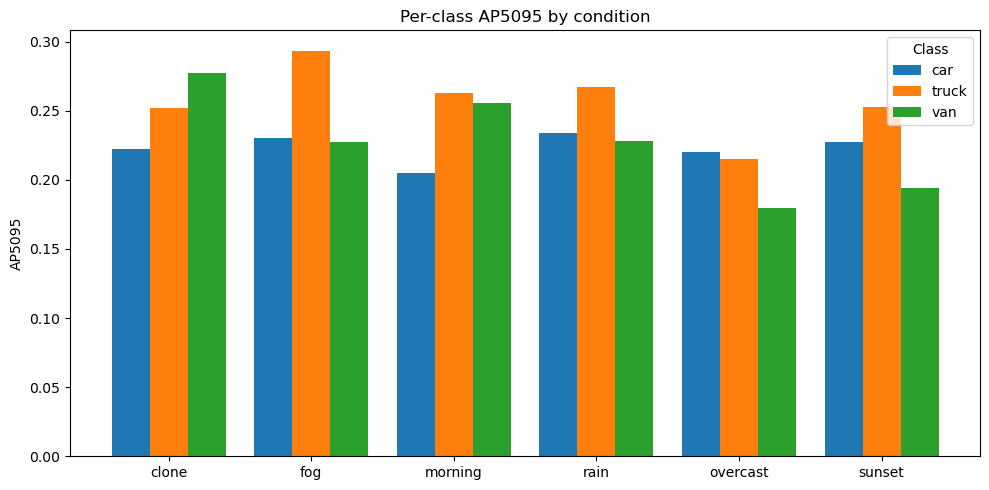

In [ ]:
# ===== Grouped bar chart: per-class AP (colors per class) =====
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Prefer the per-class CSV we wrote earlier
per_class_csv = "reports/metrics_per_class.csv"
if os.path.exists(per_class_csv):
    df_pc = pd.read_csv(per_class_csv)
    # Keep only AP5095 (COCO-style mAP) — change to "AP50" if you prefer
    metric_col = "AP5095" if "AP5095" in df_pc.columns else "AP50"
    df_pc = df_pc[["condition", "class", metric_col]].copy()
else:
    # Fallback: melt wide columns from metrics_summary if they exist (AP_car, AP_truck, AP_van)
    import re
    df_sum = pd.read_csv("reports/metrics_summary.csv")
    candidate_cols = [c for c in df_sum.columns if re.match(r"^AP_(.+)$", c)]
    if not candidate_cols:
        raise RuntimeError("No per-class metrics found in either metrics_per_class.csv or metrics_summary.csv")
    df_pc = df_sum.melt(id_vars="condition",
                        value_vars=candidate_cols,
                        var_name="class",
                        value_name="AP")
    # Normalize class names
    df_pc["class"] = df_pc["class"].str.replace("^AP_", "", regex=True)
    metric_col = "AP"

# Order conditions as they appear in the summary file (if present)
try:
    df_order = pd.read_csv("reports/metrics_summary.csv")
    cond_order = df_order["condition"].tolist()
    df_pc["condition"] = pd.Categorical(df_pc["condition"], categories=cond_order, ordered=True)
    df_pc = df_pc.sort_values(["condition", "class"])
except Exception:
    pass

# Get unique lists
conds = df_pc["condition"].dropna().unique().tolist()
classes = df_pc["class"].dropna().unique().tolist()

# Pivot to [condition x class]
pivot = df_pc.pivot(index="condition", columns="class", values=metric_col).reindex(conds)

# Plot: grouped bars (each class = different color)
plt.figure(figsize=(10,5))
x = np.arange(len(conds))
n_cls = len(classes)
width = 0.8 / max(n_cls, 1)

for i, cls in enumerate(classes):
    heights = pivot[cls].values if cls in pivot.columns else np.zeros(len(conds))
    # center groups on each condition; offset bars by class index
    offsets = x - 0.4 + (i + 0.5) * width
    plt.bar(offsets, heights, width=width, label=str(cls))

plt.xticks(x, conds, rotation=0)
plt.ylabel(metric_col)
plt.title(f"Per-class {metric_col} by condition")
plt.legend(title="Class")
plt.tight_layout()
plt.show()


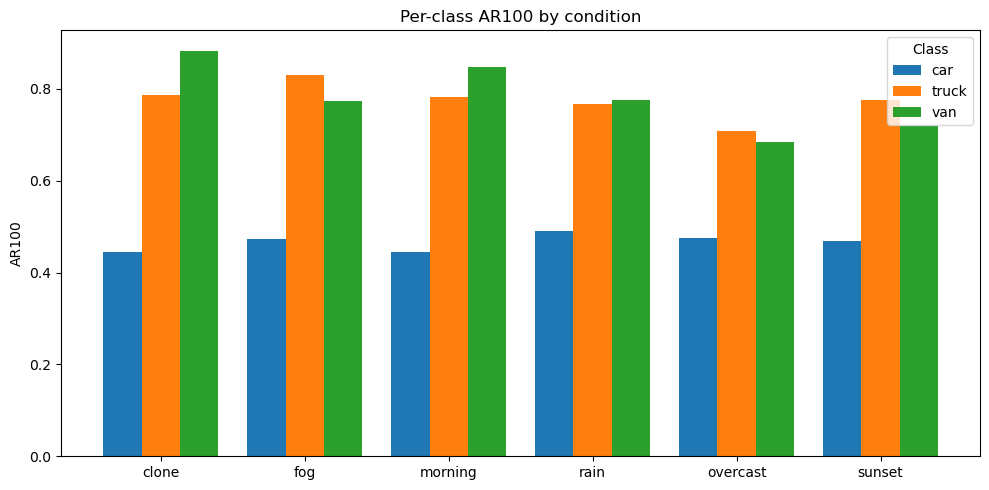

In [ ]:
# ===== Grouped bar chart: per-class Recall (colors per class) =====
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

per_class_csv = "reports/metrics_per_class.csv"
if not os.path.exists(per_class_csv):
    raise RuntimeError("Expected reports/metrics_per_class.csv to exist. Generate it from the evaluation step first.")

df_pc = pd.read_csv(per_class_csv)

# Choose which recall metric to plot; prefer AR100 -> AR10 -> AR1
rec_metric = None
for cand in ["AR100", "AR10", "AR1"]:
    if cand in df_pc.columns:
        rec_metric = cand
        break
if rec_metric is None:
    raise RuntimeError("No per-class recall columns found (AR100/AR10/AR1).")

df_pc = df_pc[["condition", "class", rec_metric]].copy()

# Order conditions as they appear in the overall summary (if available)
try:
    df_order = pd.read_csv("reports/metrics_summary.csv")
    cond_order = df_order["condition"].tolist()
    df_pc["condition"] = pd.Categorical(df_pc["condition"], categories=cond_order, ordered=True)
    df_pc = df_pc.sort_values(["condition", "class"])
except Exception:
    pass

# Unique lists
conds = df_pc["condition"].dropna().unique().tolist()
classes = df_pc["class"].dropna().unique().tolist()

# Pivot to [condition x class]
pivot = df_pc.pivot(index="condition", columns="class", values=rec_metric).reindex(conds)

# Plot: grouped bars (each class = different color)
plt.figure(figsize=(10,5))
x = np.arange(len(conds))
n_cls = max(len(classes), 1)
width = 0.8 / n_cls

for i, cls in enumerate(classes):
    heights = pivot[cls].values if cls in pivot.columns else np.zeros(len(conds))
    offsets = x - 0.4 + (i + 0.5) * width
    plt.bar(offsets, heights, width=width, label=str(cls))

plt.xticks(x, conds)
plt.ylabel(rec_metric)
plt.title(f"Per-class {rec_metric} by condition")
plt.legend(title="Class")
plt.tight_layout()
plt.show()


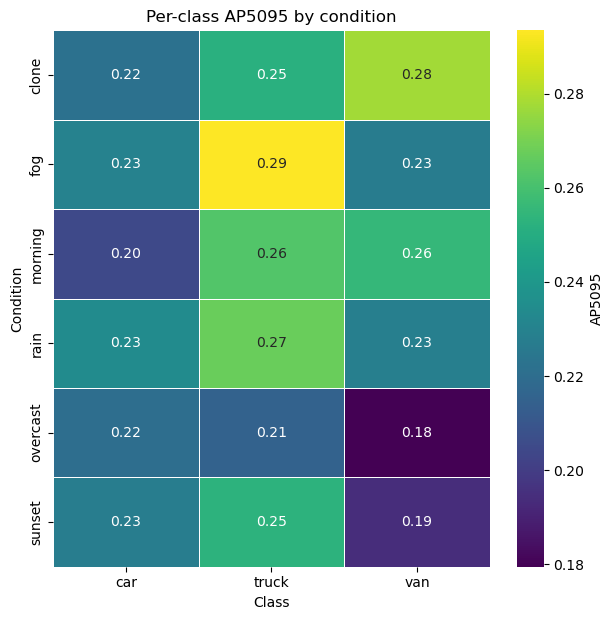

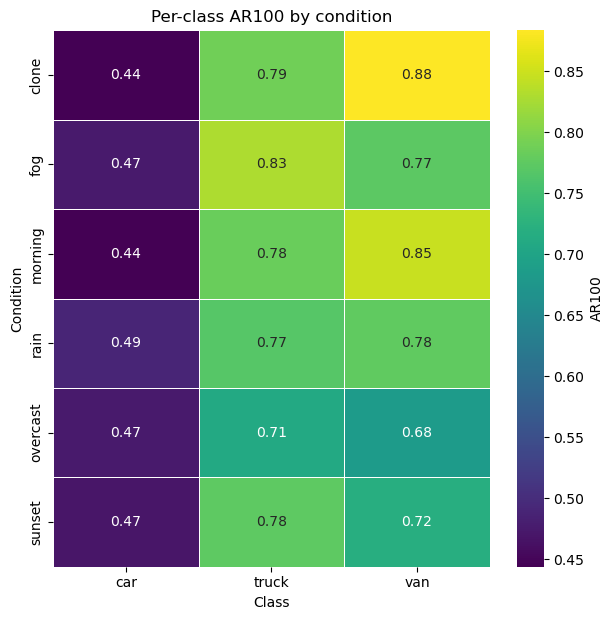

In [ ]:
# heatmap conditions vs class for percision and recall metrics

import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

per_class_csv = "reports/metrics_per_class.csv"
if not os.path.exists(per_class_csv):
    raise RuntimeError("Expected reports/metrics_per_class.csv")

df = pd.read_csv(per_class_csv)

# Keep condition order consistent with metrics_summary.csv if present
try:
    df_order = pd.read_csv("reports/metrics_summary.csv")
    cond_order = df_order["condition"].tolist()
    df["condition"] = pd.Categorical(df["condition"], categories=cond_order, ordered=True)
except Exception:
    pass

def heatmap(df_pc: pd.DataFrame, metric: str, title: str, fmt=".2f", cmap="viridis", vmin=None, vmax=None):
    if metric not in df_pc.columns:
        raise ValueError(f"Metric '{metric}' not found in columns.")
    pivot = (df_pc.pivot(index="condition", columns="class", values=metric)
                    .sort_index())  # respects Categorical order
    plt.figure(figsize=(1.1 * pivot.shape[1] + 3, 0.55 * pivot.shape[0] + 3))
    ax = sns.heatmap(
        pivot, annot=True, fmt=fmt, cmap=cmap, linewidths=0.5,
        linecolor="white", cbar_kws={"label": metric}, vmin=vmin, vmax=vmax
    )
    ax.set_title(title)
    ax.set_xlabel("Class")
    ax.set_ylabel("Condition")
    plt.tight_layout()
    plt.show()

# -------- AP heatmap (prefers AP5095 else AP50) --------
ap_metric = "AP5095" if "AP5095" in df.columns else ("AP50" if "AP50" in df.columns else None)
if ap_metric is None:
    raise RuntimeError("No AP columns found (AP5095/AP50).")
heatmap(df[["condition","class", ap_metric]], ap_metric, f"Per-class {ap_metric} by condition")

# -------- Recall heatmap (prefers AR100 -> AR10 -> AR1) --------
rec_metric = next((m for m in ["AR100","AR10","AR1"] if m in df.columns), None)
if rec_metric:
    heatmap(df[["condition","class", rec_metric]], rec_metric, f"Per-class {rec_metric} by condition")
else:
    print("[info] No recall columns (AR100/AR10/AR1); skipping recall heatmap.")

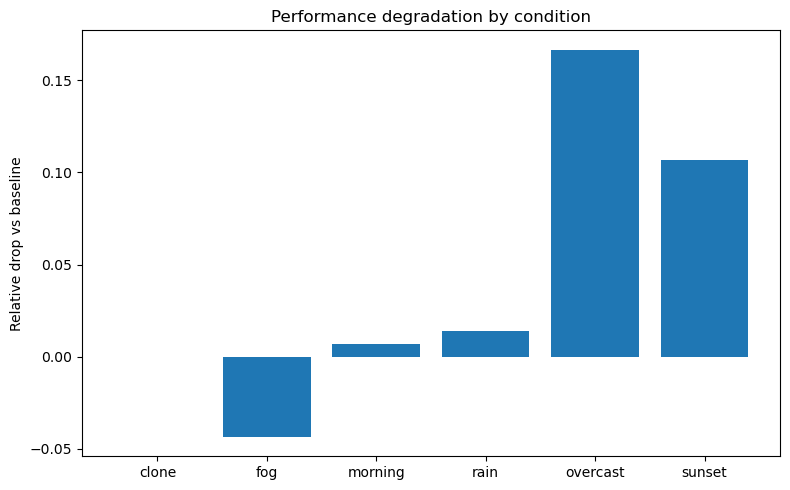

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

df = pd.read_csv("reports/metrics_summary.csv")

# Pick a baseline
if "clone" in df["condition"].values:
    baseline = df.loc[df["condition"] == "clone", "mAP50"].iloc[0]
else:
    # fall back to best mAP50 across conditions (or pick a specific one)
    baseline = df["mAP50"].max()

# Guard against zero baseline
baseline = float(baseline)
df["rel_drop"] = 1.0 if baseline == 0 else 1 - (df["mAP50"] / baseline)

plt.figure(figsize=(8,5))
plt.bar(df["condition"], df["rel_drop"])
plt.ylabel("Relative drop vs baseline")
plt.title("Performance degradation by condition")
plt.tight_layout()
plt.show()
